# XAI Group 77 Code for Midterm 

## Chrysanthi Foti
## Eleftherios Tetteris
## Nikolaos Athanasopoulos

# Necessary Installs

#### Please un-comment the following cells and run them

In [1]:
#!pip install lime

In [2]:
#!pip install shap

In [3]:
#!pip install alibi

In [4]:
#!pip install anchor-exp

# Imports

In [5]:
# Import Libraries
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
import plotly.offline as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
py.init_notebook_mode(connected=True) 
import plotly.graph_objs as go 
import plotly.tools as tls 
from collections import Counter

from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import chi2, mutual_info_classif, SelectKBest, RFE
import time
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from imblearn.over_sampling import RandomOverSampler
import lime
from lime import lime_tabular
import shap
import random
from anchor import utils
from anchor import anchor_tabular
from alibi.explainers import AnchorTabular
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from tabulate import tabulate



# General Information about dataset

In [6]:
german = pd.read_csv('german_credit_data.csv',index_col=0) 
# Please read the csv with 'index_col = 0' configuration to remove unneccesary column

In [7]:
german.head() 

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
0,67,male,2,own,NaN,little,1169,6,radio/TV,good
1,22,female,2,own,little,moderate,5951,48,radio/TV,bad
2,49,male,1,own,little,NaN,2096,12,education,good
3,45,male,2,free,little,little,7882,42,furniture/equipment,good
4,53,male,2,free,little,little,4870,24,car,bad


In [8]:
german.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000 entries, 0 to 999
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Age               1000 non-null   int64 
 1   Sex               1000 non-null   object
 2   Job               1000 non-null   int64 
 3   Housing           1000 non-null   object
 4   Saving accounts   817 non-null    object
 5   Checking account  606 non-null    object
 6   Credit amount     1000 non-null   int64 
 7   Duration          1000 non-null   int64 
 8   Purpose           1000 non-null   object
 9   Risk              1000 non-null   object
dtypes: int64(4), object(6)
memory usage: 85.9+ KB


In [9]:
german.dtypes

Age                  int64
Sex                 object
Job                  int64
Housing             object
Saving accounts     object
Checking account    object
Credit amount        int64
Duration             int64
Purpose             object
Risk                object
dtype: object

In [10]:
german.nunique()

Age                  53
Sex                   2
Job                   4
Housing               3
Saving accounts       4
Checking account      3
Credit amount       921
Duration             33
Purpose               8
Risk                  2
dtype: int64

In [11]:
german.describe(include=['object'])

,Sex,Housing,Saving accounts,Checking account,Purpose,Risk
count,1000,1000,817,606,1000,1000
unique,2,3,4,3,8,2
top,male,own,little,little,car,good
freq,690,713,603,274,337,700


In [12]:
german.describe()

,Age,Job,Credit amount,Duration
count,1000.000000,1000.000000,1000.000000,1000.000000
mean,35.546000,1.904000,3271.258000,20.903000
std,11.375469,0.653614,2822.736876,12.058814
min,19.000000,0.000000,250.000000,4.000000
25%,27.000000,2.000000,1365.500000,12.000000
50%,33.000000,2.000000,2319.500000,18.000000
75%,42.000000,2.000000,3972.250000,24.000000
max,75.000000,3.000000,18424.000000,72.000000


In [13]:
categorical_columns = []
for col in german.select_dtypes(include=[object]):
    print('')
    print(col,":", german[col].unique())
    categorical_columns.append(col)


Sex : ['male' 'female']

Housing : ['own' 'free' 'rent']

Saving accounts : [nan 'little' 'quite rich' 'rich' 'moderate']

Checking account : ['little' 'moderate' nan 'rich']

Purpose : ['radio/TV' 'education' 'furniture/equipment' 'car' 'business'
 'domestic appliances' 'repairs' 'vacation/others']

Risk : ['good' 'bad']


In [14]:
german.isnull().sum().sort_values(ascending=False)

Checking account    394
Saving accounts     183
Age                   0
Sex                   0
Job                   0
Housing               0
Credit amount         0
Duration              0
Purpose               0
Risk                  0
dtype: int64

<AxesSubplot:>

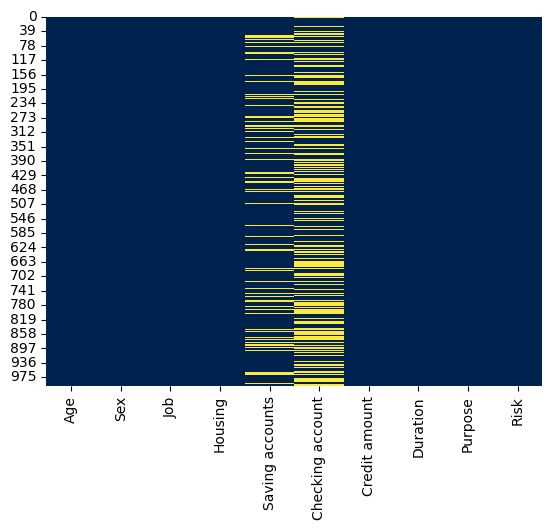

In [15]:
sns.heatmap(german.isnull(), cbar=False, cmap = 'cividis')

In [16]:
german.isnull().sum()

Age                   0
Sex                   0
Job                   0
Housing               0
Saving accounts     183
Checking account    394
Credit amount         0
Duration              0
Purpose               0
Risk                  0
dtype: int64

<BarContainer object of 10 artists>

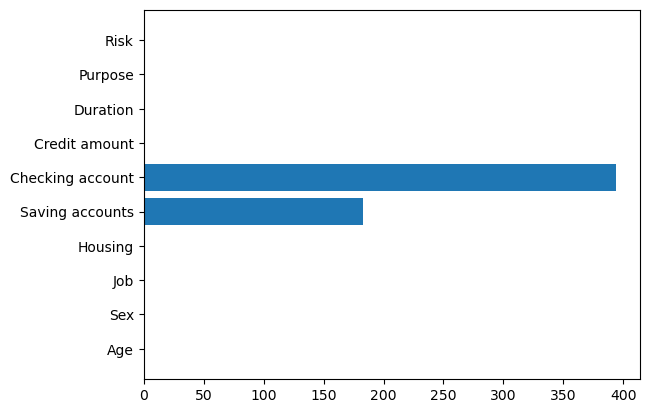

In [17]:
plt.barh(y= german.columns, width = german.isnull().sum())

In [18]:
german['Checking account'].mode()

0    little
Name: Checking account, dtype: object

In [19]:
for col in german.columns:
    print(col)
    print(german[col].mode())
    print('-'*20)

Age
0    27
Name: Age, dtype: int64
--------------------
Sex
0    male
Name: Sex, dtype: object
--------------------
Job
0    2
Name: Job, dtype: int64
--------------------
Housing
0    own
Name: Housing, dtype: object
--------------------
Saving accounts
0    little
Name: Saving accounts, dtype: object
--------------------
Checking account
0    little
Name: Checking account, dtype: object
--------------------
Credit amount
0    1258
1    1262
2    1275
3    1393
4    1478
Name: Credit amount, dtype: int64
--------------------
Duration
0    24
Name: Duration, dtype: int64
--------------------
Purpose
0    car
Name: Purpose, dtype: object
--------------------
Risk
0    good
Name: Risk, dtype: object
--------------------




### Filling nan values with mode

In [20]:
german = german.fillna(german.mode().iloc[0])
german.head()


,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
0,67,male,2,own,little,little,1169,6,radio/TV,good
1,22,female,2,own,little,moderate,5951,48,radio/TV,bad
2,49,male,1,own,little,little,2096,12,education,good
3,45,male,2,free,little,little,7882,42,furniture/equipment,good
4,53,male,2,free,little,little,4870,24,car,bad


In [21]:
sns.set(rc = {'figure.figsize':(16,8)})


### Correlation matrix between numeric columns only

<AxesSubplot:>

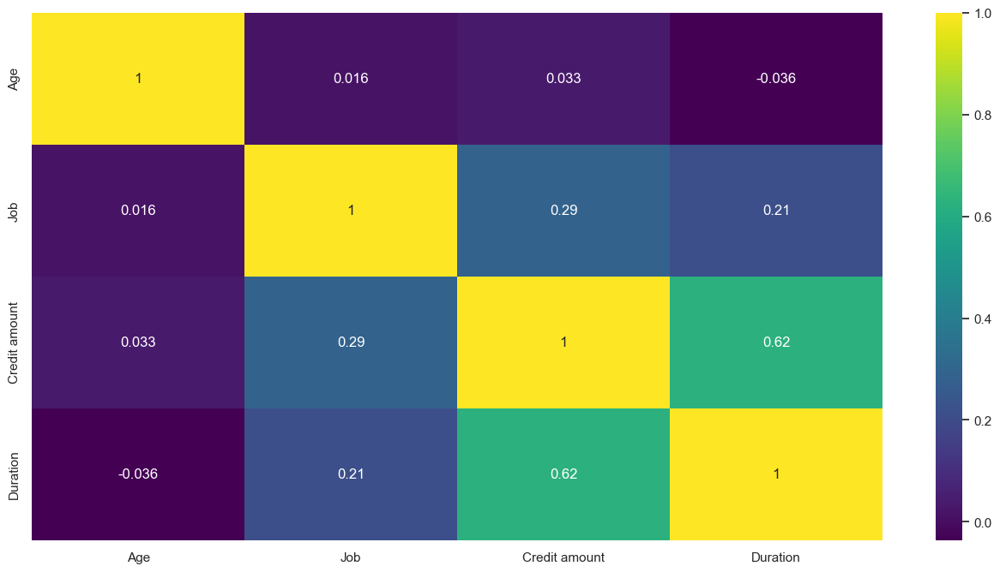

In [22]:
sns.heatmap(german.corr(), annot=True, fmt='.2g', cmap='viridis')

<AxesSubplot:xlabel='Credit amount', ylabel='Duration'>

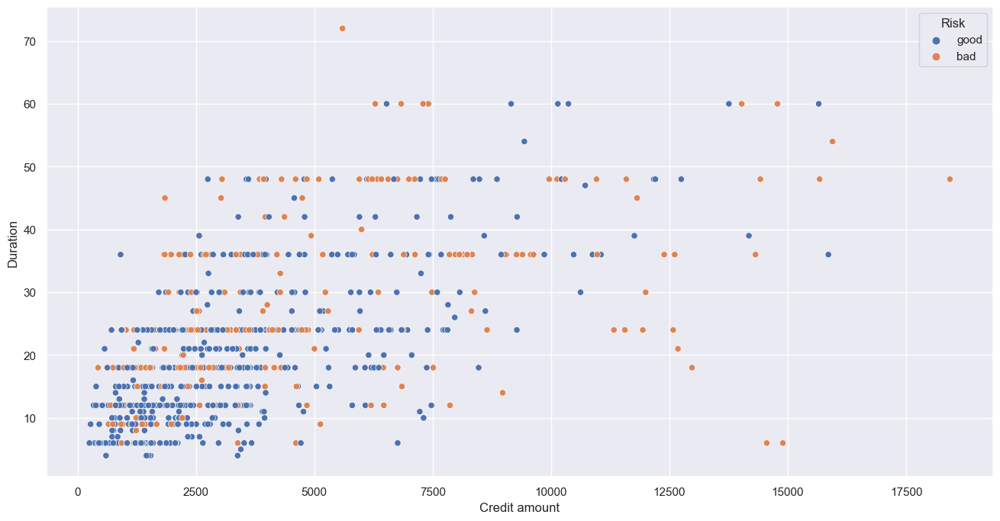

In [23]:
sns.scatterplot(data=german, x="Credit amount", y="Duration", hue="Risk")

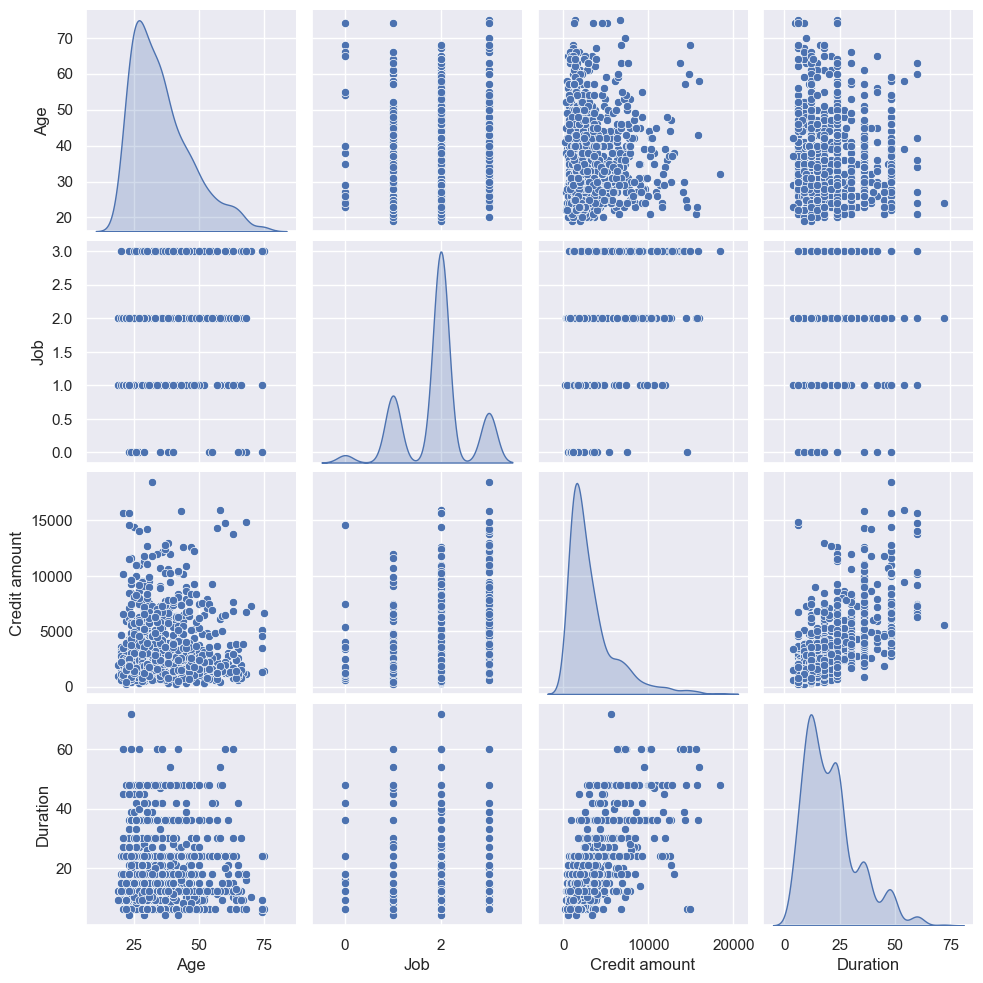

In [24]:
# Interactions between features in the dataset (take a few minutes)
sns.pairplot(german, kind="scatter", diag_kind="kde")

# Data Distributions

### Distributions for numeric columns

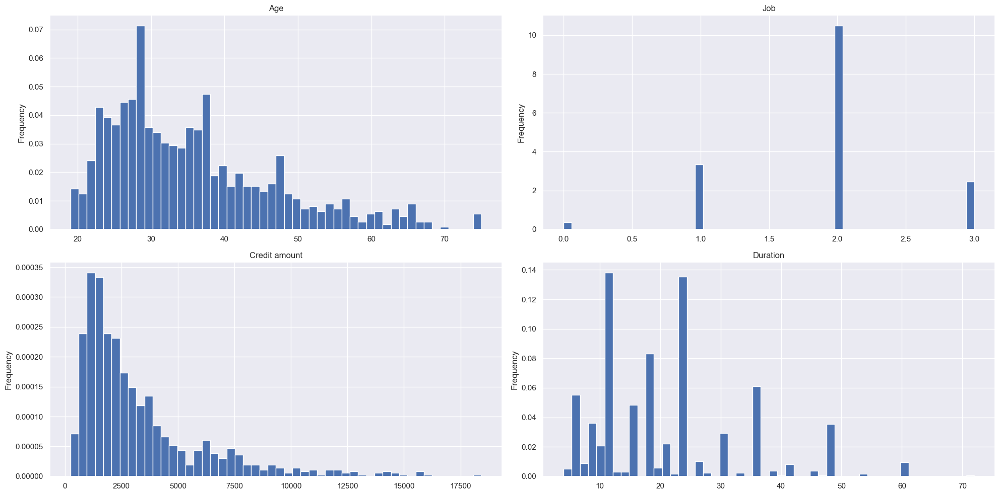

In [25]:
fig, axes = plt.subplots(nrows= 2, ncols = 2, figsize=(20,10))

num_cols = german.select_dtypes(include=['int', 'float']).columns

for i, column in enumerate(num_cols):
    row = i // 2
    col = i % 2 
    german[column].plot.hist(density = True, ax=axes[row, col], bins=50)
    #german[column].plot.kde(ax=axes[row, col])
    axes[row, col].set_title(column)
    
plt.tight_layout()
plt.show()     

<AxesSubplot:xlabel='Job', ylabel='count'>

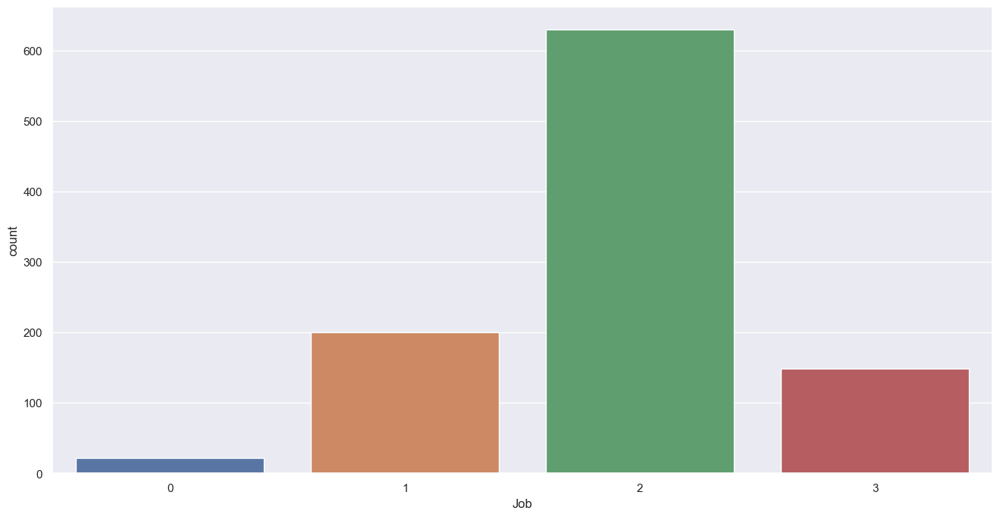

In [26]:
# Countplot for Column Job #

sns.countplot(data=german, x='Job')


### Distributions for categorical columns

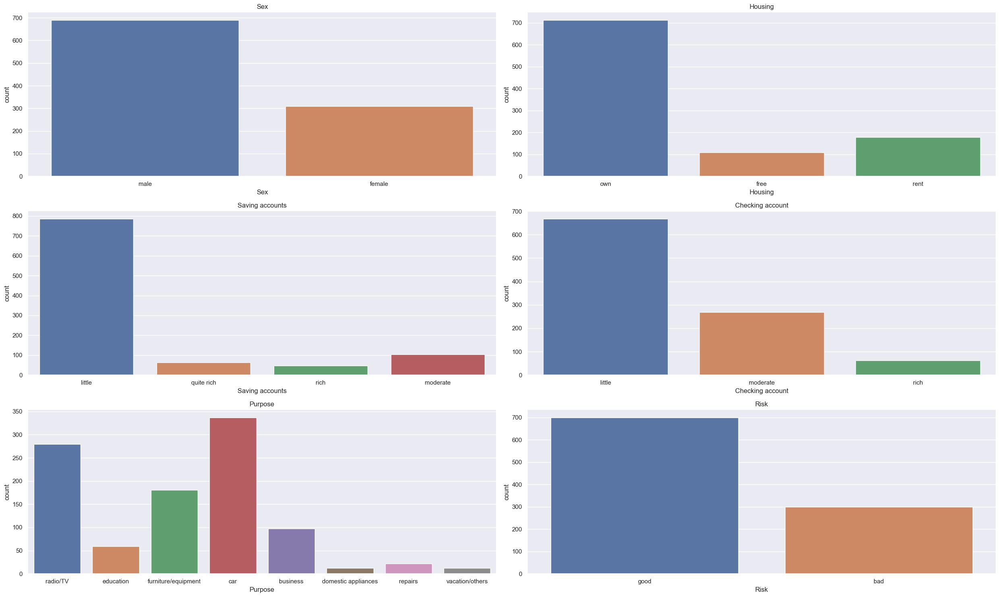

In [27]:
fig, axes = plt.subplots(nrows= 3, ncols = 2, figsize=(25,15))

cat_cols = german.select_dtypes(include=['object']).columns

for i, column in enumerate(cat_cols):
    row = i // 2
    col = i % 2
    sns.countplot(data=german, x=column, ax=axes[row, col])
    #german[column].plot.kde(ax=axes[row, col])
    axes[row, col].set_title(column)
    
plt.tight_layout()
plt.show()    

## Encoding categorical columns

In [28]:
le = LabelEncoder()
class_list = []

for col in german.select_dtypes(include=[object]):
    le.fit(german[col]) 
    print(col)
    print(dict(zip(le.classes_, le.transform(le.classes_))))
    class_list.append(dict(zip(le.classes_, le.transform(le.classes_))))
    german[col] = le.fit_transform(german[col])
    print('-'*50)

Sex
{'female': 0, 'male': 1}
--------------------------------------------------
Housing
{'free': 0, 'own': 1, 'rent': 2}
--------------------------------------------------
Saving accounts
{'little': 0, 'moderate': 1, 'quite rich': 2, 'rich': 3}
--------------------------------------------------
Checking account
{'little': 0, 'moderate': 1, 'rich': 2}
--------------------------------------------------
Purpose
{'business': 0, 'car': 1, 'domestic appliances': 2, 'education': 3, 'furniture/equipment': 4, 'radio/TV': 5, 'repairs': 6, 'vacation/others': 7}
--------------------------------------------------
Risk
{'bad': 0, 'good': 1}
--------------------------------------------------


In [29]:
german.head()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
0,67,1,2,1,0,0,1169,6,5,1
1,22,0,2,1,0,1,5951,48,5,0
2,49,1,1,1,0,0,2096,12,3,1
3,45,1,2,0,0,0,7882,42,4,1
4,53,1,2,0,0,0,4870,24,1,0


In [30]:
german.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000 entries, 0 to 999
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype
---  ------            --------------  -----
 0   Age               1000 non-null   int64
 1   Sex               1000 non-null   int32
 2   Job               1000 non-null   int64
 3   Housing           1000 non-null   int32
 4   Saving accounts   1000 non-null   int32
 5   Checking account  1000 non-null   int32
 6   Credit amount     1000 non-null   int64
 7   Duration          1000 non-null   int64
 8   Purpose           1000 non-null   int32
 9   Risk              1000 non-null   int32
dtypes: int32(6), int64(4)
memory usage: 94.8 KB


In [31]:
german.describe()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,35.546000,0.690000,1.904000,1.071000,0.373000,0.395000,3271.258000,20.903000,2.878000,0.700000
std,11.375469,0.462725,0.653614,0.531264,0.805307,0.604434,2822.736876,12.058814,1.978138,0.458487
min,19.000000,0.000000,0.000000,0.000000,0.000000,0.000000,250.000000,4.000000,0.000000,0.000000
25%,27.000000,0.000000,2.000000,1.000000,0.000000,0.000000,1365.500000,12.000000,1.000000,0.000000
50%,33.000000,1.000000,2.000000,1.000000,0.000000,0.000000,2319.500000,18.000000,3.000000,1.000000
75%,42.000000,1.000000,2.000000,1.000000,0.000000,1.000000,3972.250000,24.000000,5.000000,1.000000
max,75.000000,1.000000,3.000000,2.000000,3.000000,2.000000,18424.000000,72.000000,7.000000,1.000000


In [32]:
german.isnull().sum().sort_values(ascending=False)

Age                 0
Sex                 0
Job                 0
Housing             0
Saving accounts     0
Checking account    0
Credit amount       0
Duration            0
Purpose             0
Risk                0
dtype: int64

In [33]:
class_list

[{'female': 0, 'male': 1},
 {'free': 0, 'own': 1, 'rent': 2},
 {'little': 0, 'moderate': 1, 'quite rich': 2, 'rich': 3},
 {'little': 0, 'moderate': 1, 'rich': 2},
 {'business': 0,
  'car': 1,
  'domestic appliances': 2,
  'education': 3,
  'furniture/equipment': 4,
  'radio/TV': 5,
  'repairs': 6,
  'vacation/others': 7},
 {'bad': 0, 'good': 1}]

### All the distributions together, encoded

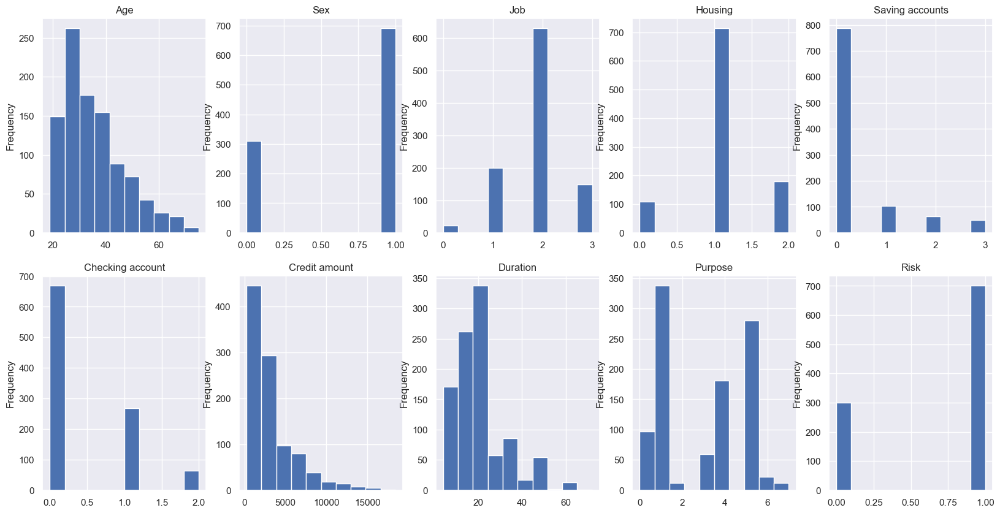

In [34]:
fig, axes = plt.subplots(nrows= 2, ncols = 5, figsize=(20,10))

for i, column in enumerate(german.columns):
    row = i // 5
    col = i % 5 
    german[column].plot.hist(ax=axes[row, col])
    axes[row, col].set_title(column)


## Feature Correlations

<AxesSubplot:>

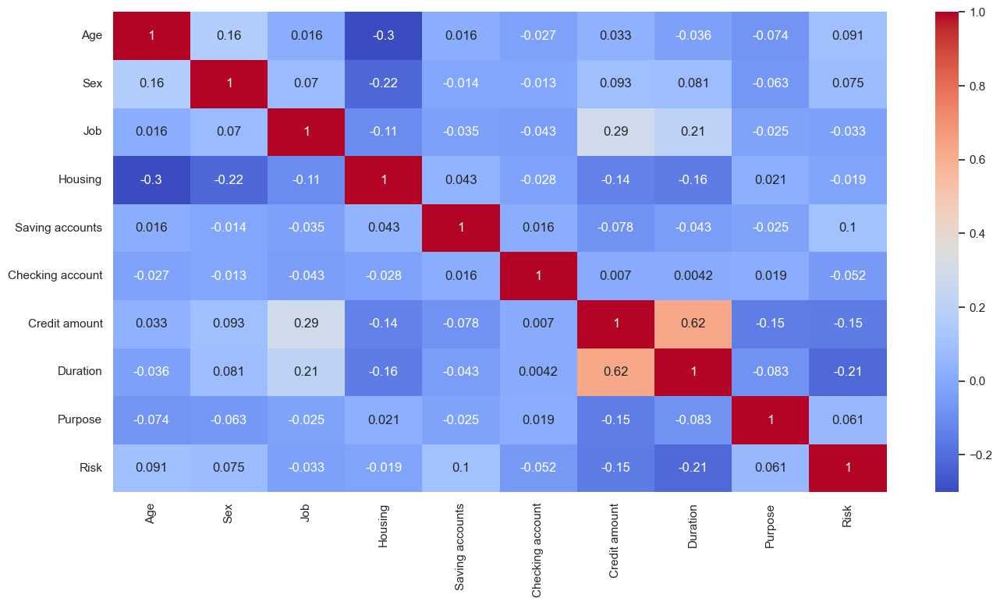

In [35]:
sns.heatmap(german.corr(), annot=True, fmt='.2g', cmap='coolwarm')

## Pairplots

Time to complete cell was: 9.53559684753418 seconds


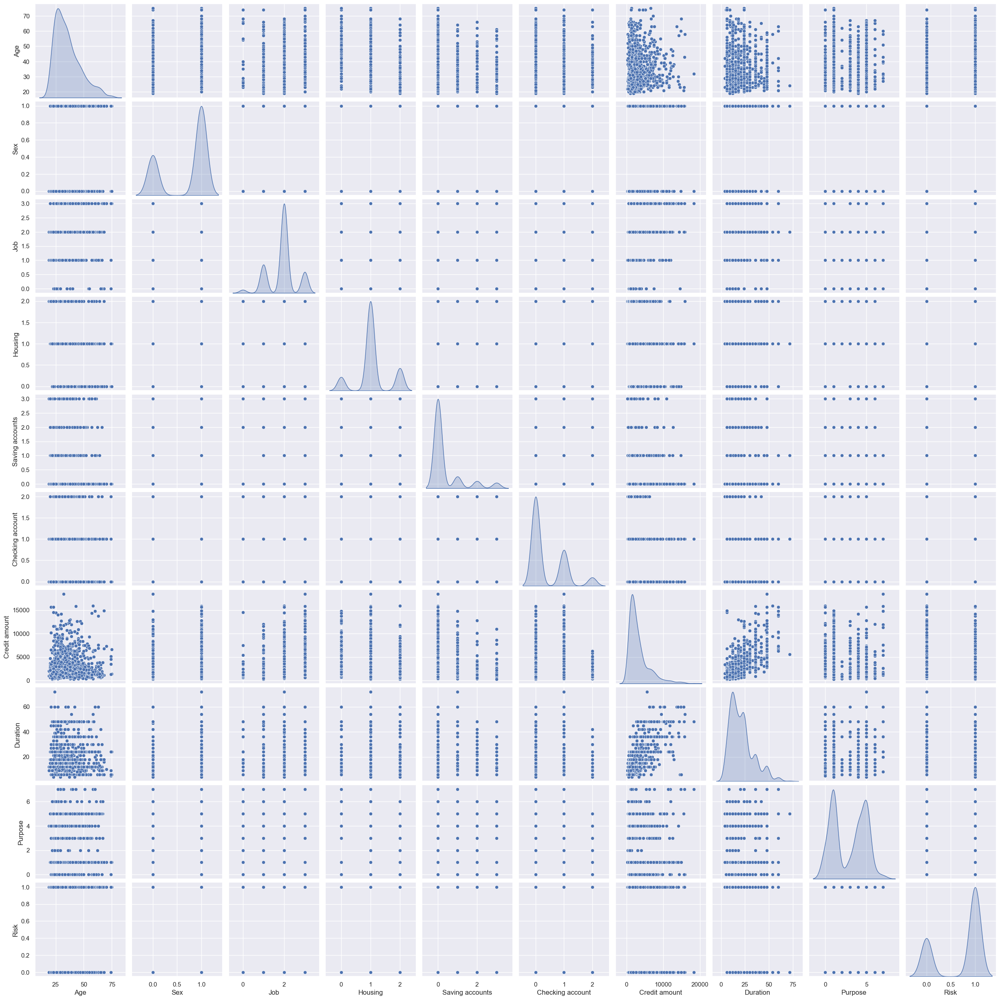

In [36]:
start = time.time()
sns.pairplot(german, kind="scatter", diag_kind="kde")
end = time.time()

print(f'Time to complete cell was: {end-start} seconds') ### 10 seconds usually

## Male - Female Credit Distribution

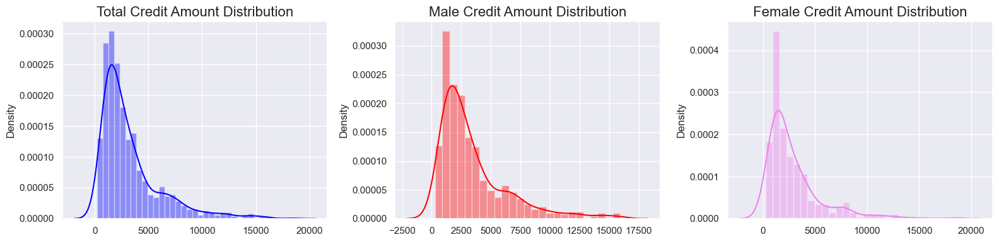

In [37]:
overall = german['Credit amount'].values  # Total credit amounts
male = german[german['Sex'] == 1]['Credit amount'].values # Credit amounts of male
female = german[german['Sex'] == 0]['Credit amount'].values # Credit amounts of female

fig, ax = plt.subplots(1, 3, figsize=(16,4)) # Define subplots - 1 row 3 column
sns.distplot(overall, ax=ax[0], color= 'blue')
ax[0].set_title("Total Credit Amount Distribution", fontsize=16) # Distribution plot of total credit amounts
sns.distplot(male, ax=ax[1], color="red") # Distribution plot of male credit amounts
ax[1].set_title("Male Credit Amount Distribution", fontsize=16)
sns.distplot(female, ax=ax[2], color="violet") # Distribution plot of female credit amounts
ax[2].set_title("Female Credit Amount Distribution", fontsize=16)
fig.tight_layout()
plt.show()

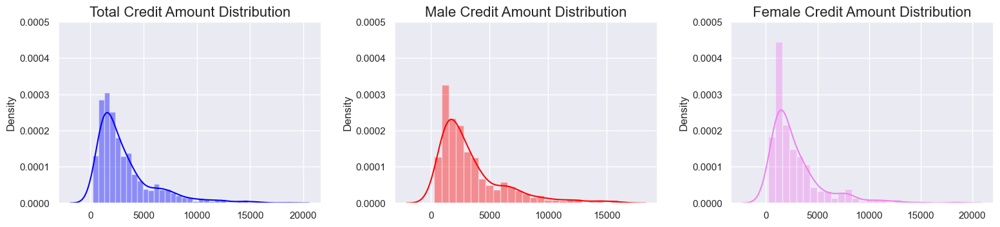

In [38]:
overall = german['Credit amount'].values  # Total credit amounts
male = german[german['Sex'] == 1]['Credit amount'].values # Credit amounts of male
female = german[german['Sex'] == 0]['Credit amount'].values # Credit amounts of female

## we can pick the highest value and uniform all distributions to have an equal y 
ref_y_value = 0.0005
fig, ax = plt.subplots(1, 3, figsize=(16,4)) # Define subplots - 1 row 3 column
sns.distplot(overall, ax=ax[0], color= 'blue')
ax[0].set_title("Total Credit Amount Distribution", fontsize=16) # Distribution plot of total credit amounts
ax[0].set_ylim(0, ref_y_value)
sns.distplot(male, ax=ax[1], color="red") # Distribution plot of male credit amounts
ax[1].set_title("Male Credit Amount Distribution", fontsize=16)
ax[1].set_ylim(0, ref_y_value)
sns.distplot(female, ax=ax[2], color="violet") # Distribution plot of female credit amounts
ax[2].set_title("Female Credit Amount Distribution", fontsize=16)
ax[2].set_ylim(0, ref_y_value)
fig.tight_layout(pad=2.0)
plt.show()

## Housing - Credit amount Distribution

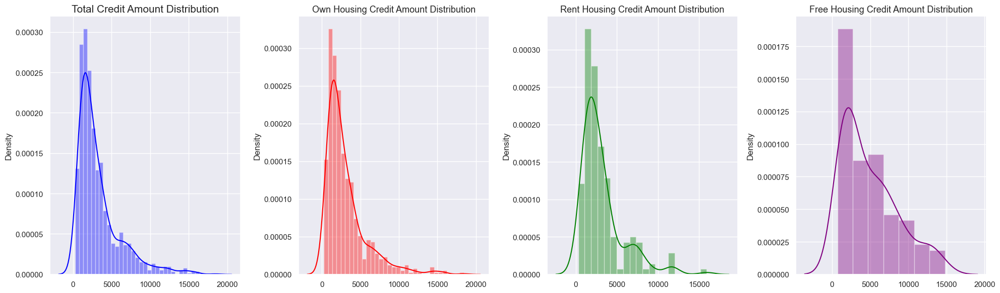

In [39]:
overall = german['Credit amount'].values  # Total credit amounts
own = german[german['Housing'] == 1]['Credit amount'].values # Credit amounts of own housing
rent = german[german['Housing'] == 2]['Credit amount'].values # Credit amounts of rent housing
free = german[german['Housing'] == 0]['Credit amount'].values # Credit amounts of free housing

fig, ax = plt.subplots(1, 4, figsize=(20,6)) # Define subplots - 1 row 4 column
sns.distplot(overall, ax=ax[0], color= 'blue')     # Distribution plot of total credit amounts
ax[0].set_title("Total Credit Amount Distribution", fontsize=15) 
sns.distplot(own, ax=ax[1], color="red") # Distribution plot of own housing credit amounts
ax[1].set_title("Own Housing Credit Amount Distribution", fontsize=13)
sns.distplot(rent, ax=ax[2], color="green") # Distribution plot of rent housing credit amounts
ax[2].set_title("Rent Housing Credit Amount Distribution", fontsize=13)
sns.distplot(free, ax=ax[3], color="purple") # Distribution plot of free housing credit amounts
ax[3].set_title("Free Housing Credit Amount Distribution", fontsize=13)
fig.tight_layout()
plt.show()

## Saving account - Credit amount distribution

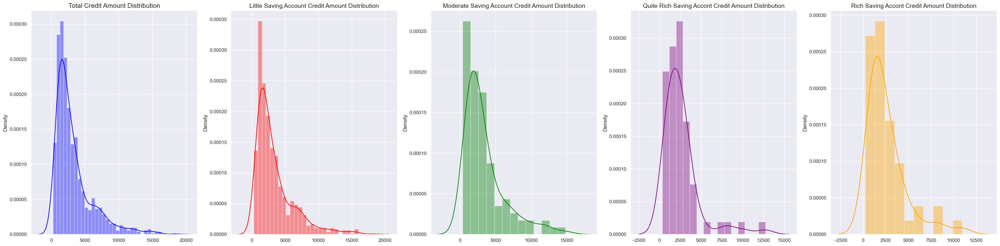

In [40]:
overall = german['Credit amount'].values  # Total credit amounts
little = german[german['Saving accounts'] == 0]['Credit amount'].values # Credit amounts of little saving account
moderate = german[german['Saving accounts'] == 1]['Credit amount'].values # Credit amounts of moderate saving account
qrich = german[german['Saving accounts'] == 2]['Credit amount'].values # Credit amounts of quite rich saving account
rich = german[german['Saving accounts'] == 3]['Credit amount'].values # Credit amounts of rich saving account

fig, ax = plt.subplots(1, 5, figsize=(32,8)) # Define subplots - 1 row 5 column
sns.distplot(overall, ax=ax[0], color= 'blue')   # Distribution plot of total credit amounts
ax[0].set_title("Total Credit Amount Distribution", fontsize=15) 
sns.distplot(little, ax=ax[1], color="red") # Distribution plot of little savings credit amounts
ax[1].set_title("Little Saving Account Credit Amount Distribution", fontsize=14)
sns.distplot(moderate, ax=ax[2], color="green") # Distribution plot of moderate savings credit amounts
ax[2].set_title("Moderate Saving Account Credit Amount Distribution", fontsize=14)
sns.distplot(qrich, ax=ax[3], color="purple") # Distribution plot of quite rich savings credit amounts
ax[3].set_title("Quite Rich Saving Accont Credit Amount Distribution", fontsize=14)
sns.distplot(rich, ax=ax[4], color="orange") # Distribution plot of rich credit amounts
ax[4].set_title("Rich Saving Accont Credit Amount Distribution", fontsize=14)
fig.tight_layout()
plt.show()

## Checking account - Credit amount distribution

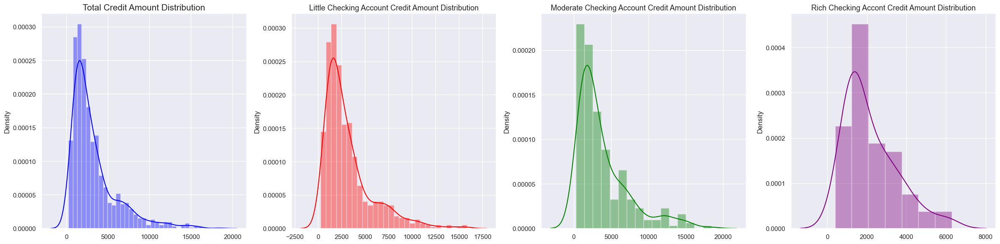

In [41]:
overall = german['Credit amount'].values  # Total credit amounts
little = german[german['Checking account'] == 0]['Credit amount'].values # Credit amounts of little checking account
moderate = german[german['Checking account'] == 1]['Credit amount'].values # Credit amounts of moderate checking account
rich = german[german['Checking account'] == 2]['Credit amount'].values # Credit amounts of rich checking account

fig, ax = plt.subplots(1, 4, figsize=(24,6)) # Define subplots - 1 row 4 column
sns.distplot(overall, ax=ax[0], color= 'blue')   # Distribution plot of total credit amounts
ax[0].set_title("Total Credit Amount Distribution", fontsize=15) 
sns.distplot(little, ax=ax[1], color="red") # Distribution plot of little checking credit amounts
ax[1].set_title("Little Checking Account Credit Amount Distribution", fontsize=13)
sns.distplot(moderate, ax=ax[2], color="green") # Distribution plot of moderate checking credit amounts
ax[2].set_title("Moderate Checking Account Credit Amount Distribution", fontsize=13)
sns.distplot(rich, ax=ax[3], color="purple") # Distribution plot of rich checking credit amounts
ax[3].set_title("Rich Checking Accont Credit Amount Distribution", fontsize=13)
fig.tight_layout()
plt.show()

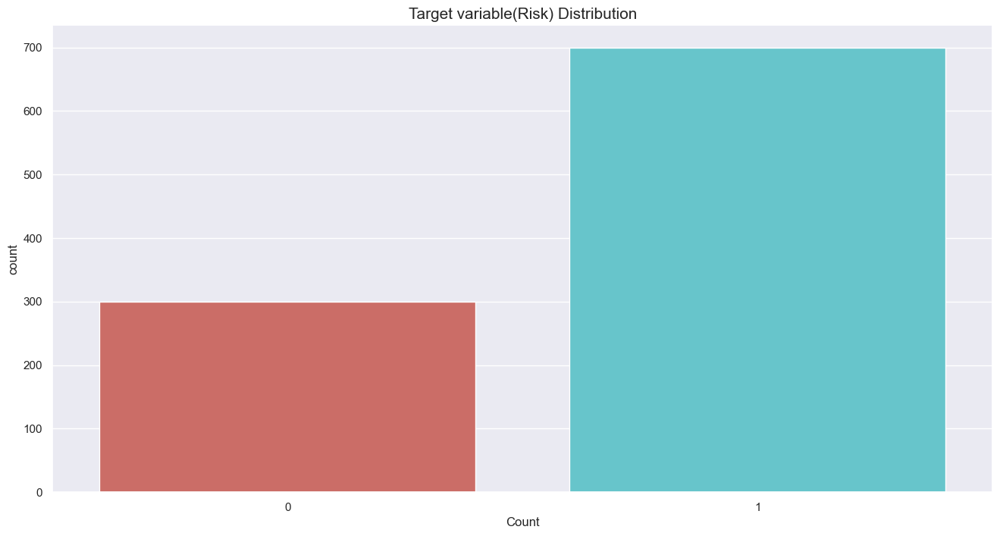

In [42]:
g1 = sns.countplot(x="Risk",data= german, palette="hls")                  
g1.set_title("Target variable(Risk) Distribution", fontsize=15)
g1.set_xlabel("Risk")
g1.set_xlabel("Count")
plt.show()

## Age - Risk Distribution

In [43]:
df_good = german.loc[german["Risk"] == 1]['Age'].values.tolist() # Age of people with good credit risk
df_bad = german.loc[german["Risk"] == 0]['Age'].values.tolist()   # Age of people with bad credit risk
df_age = german['Age'].values.tolist()

# Age distribution of people with good credit risk
trace0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Good Credit"
)
# Age distribution of people with good credit risk
trace1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Bad Credit"
)
# Age distribution of people in the dataset
trace2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall Age"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good Credit','Bad Credit', 'Overall Age Distribuition'))

#Setting the figs
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)

fig['layout'].update(showlegend=True, title='Age Distribution', bargap=0.05)
#py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')
fig.show()

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead


In [44]:
german.head()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
0,67,1,2,1,0,0,1169,6,5,1
1,22,0,2,1,0,1,5951,48,5,0
2,49,1,1,1,0,0,2096,12,3,1
3,45,1,2,0,0,0,7882,42,4,1
4,53,1,2,0,0,0,4870,24,1,0


# Fitting the models

In [45]:
X = german.drop('Risk', axis=1)
y = german['Risk']

In [46]:
X.head()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,67,1,2,1,0,0,1169,6,5
1,22,0,2,1,0,1,5951,48,5
2,49,1,1,1,0,0,2096,12,3
3,45,1,2,0,0,0,7882,42,4
4,53,1,2,0,0,0,4870,24,1


In [47]:
y.head()

0    1
1    0
2    1
3    1
4    0
Name: Risk, dtype: int32

In [48]:
class1_percent = (y.sum() / y.shape[0]) # imbalance 70% good risk, 30% bad risk
class0_percent = 1 - class1_percent
print('The percentage of class 1 (Good Risk) is {:.2%} while the percentage of class 0 (Bad Risk) is {:.2%}%'.format(class1_percent, class0_percent))

The percentage of class 1 (Good Risk) is 70.00% while the percentage of class 0 (Bad Risk) is 30.00%%


In [49]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify = y, random_state=42)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(800, 9)
(800,)
(200, 9)
(200,)


## Random Forest, no resample, no dropped columns

In [50]:
rf = RandomForestClassifier(random_state = 42)

rf.fit(X_train, y_train)

preds_rf = rf.predict(X_test)

print(classification_report(y_test, preds_rf))

              precision    recall  f1-score   support

           0       0.57      0.28      0.38        60
           1       0.75      0.91      0.82       140

    accuracy                           0.72       200
   macro avg       0.66      0.60      0.60       200
weighted avg       0.69      0.72      0.69       200



In [51]:
# conf_mat_rf = confusion_matrix(y_test, preds_rf)

# sns.heatmap(conf_mat_rf, annot=True, fmt='.2f', cmap='viridis')

## Logistic Regression, no resample, no dropped columns

In [52]:
lr = LogisticRegression(random_state = 42)

lr.fit(X_train, y_train)

preds_lr = lr.predict(X_test)

print(classification_report(y_test, preds_lr))

              precision    recall  f1-score   support

           0       0.31      0.08      0.13        60
           1       0.70      0.92      0.80       140

    accuracy                           0.67       200
   macro avg       0.51      0.50      0.46       200
weighted avg       0.58      0.67      0.60       200



In [53]:
# conf_mat_lr = confusion_matrix(y_test, preds_lr)

# sns.heatmap(conf_mat_lr, annot=True, fmt='.2f', cmap='viridis')

### Gradient Boosting Classifier, no resample, no dropped columns

In [54]:
gbc = GradientBoostingClassifier(random_state = 42)

gbc.fit(X_train, y_train)

preds_gbc = gbc.predict(X_test)

print(classification_report(y_test, preds_gbc))

              precision    recall  f1-score   support

           0       0.41      0.23      0.30        60
           1       0.72      0.86      0.78       140

    accuracy                           0.67       200
   macro avg       0.57      0.55      0.54       200
weighted avg       0.63      0.67      0.64       200



# Oversampling with imbalanced-learn random oversampler because the F1 score on Class 0 (Bad Risk) is very low

## Random Forest, oversample, no dropped columns

In [55]:
ros = RandomOverSampler(random_state=42)

X_res, y_res = ros.fit_resample(X, y)

X_train_res, X_test_res, y_train_res, y_test_res = train_test_split(X_res, 
                                                                    y_res, 
                                                                    test_size=0.2,
                                                                    stratify = y_res,
                                                                    random_state=42)

print(X_train_res.shape)
print(y_train_res.shape)
print(X_test_res.shape)
print(y_test_res.shape)


rf_res = RandomForestClassifier(random_state = 42)

rf_res.fit(X_train_res, y_train_res)

preds_rf_res = rf_res.predict(X_test_res)

print(classification_report(y_test_res, preds_rf_res)) ### 83% f1 score

(1120, 9)
(1120,)
(280, 9)
(280,)
              precision    recall  f1-score   support

           0       0.82      0.97      0.89       140
           1       0.96      0.79      0.87       140

    accuracy                           0.88       280
   macro avg       0.89      0.88      0.88       280
weighted avg       0.89      0.88      0.88       280



## Logistic Regression, oversample, no dropped columns

In [56]:
ros = RandomOverSampler(random_state=42)

X_res, y_res = ros.fit_resample(X, y)

X_train_res, X_test_res, y_train_res, y_test_res = train_test_split(X_res, 
                                                                    y_res, 
                                                                    test_size=0.2,
                                                                    stratify = y_res,
                                                                    random_state=42)

print(X_train_res.shape)
print(y_train_res.shape)
print(X_test_res.shape)
print(y_test_res.shape)


lr_res = LogisticRegression(random_state = 42)

lr_res.fit(X_train_res, y_train_res)

preds_lr_res = lr_res.predict(X_test_res)

print(classification_report(y_test_res, preds_lr_res)) ### 57% F1 score

(1120, 9)
(1120,)
(280, 9)
(280,)
              precision    recall  f1-score   support

           0       0.62      0.60      0.61       140
           1       0.61      0.64      0.62       140

    accuracy                           0.62       280
   macro avg       0.62      0.62      0.62       280
weighted avg       0.62      0.62      0.62       280



## Gradient Boosting Classifier, oversample, no dropped columns

In [57]:
gbc_res = GradientBoostingClassifier(random_state=42)

gbc_res.fit(X_train_res, y_train_res)

preds_gbc_res = gbc_res.predict(X_test_res)

print(classification_report(y_test_res, preds_gbc_res)) ### 64% F1 score

              precision    recall  f1-score   support

           0       0.74      0.80      0.77       140
           1       0.78      0.72      0.75       140

    accuracy                           0.76       280
   macro avg       0.76      0.76      0.76       280
weighted avg       0.76      0.76      0.76       280



# Resampling but dropping the variable "Sex" and seeing the results

In [58]:
german.head()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
0,67,1,2,1,0,0,1169,6,5,1
1,22,0,2,1,0,1,5951,48,5,0
2,49,1,1,1,0,0,2096,12,3,1
3,45,1,2,0,0,0,7882,42,4,1
4,53,1,2,0,0,0,4870,24,1,0


In [59]:
dropped_cols = ['Risk', 'Sex'] ### variable columns to be dropped from german credit dataset  

X_dropped = german.drop(dropped_cols, axis=1)
y_dropped = german['Risk']

X_dropped.head()

,Age,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,67,2,1,0,0,1169,6,5
1,22,2,1,0,1,5951,48,5
2,49,1,1,0,0,2096,12,3
3,45,2,0,0,0,7882,42,4
4,53,2,0,0,0,4870,24,1


## Random Forest, oversample, dropped Sex

In [60]:
ros = RandomOverSampler(random_state=42)

X_res_dropped, y_res_dropped = ros.fit_resample(X_dropped, y_dropped)

X_train_res_dropped, X_test_res_dropped, y_train_res_dropped, y_test_res_dropped = train_test_split(X_res_dropped, 
                                                                                                    y_res_dropped, 
                                                                                                    test_size=0.2,
                                                                                                    stratify = y_res_dropped,
                                                                                                    random_state=42)

print(X_train_res_dropped.shape)
print(y_train_res_dropped.shape)
print(X_test_res_dropped.shape)
print(y_test_res_dropped.shape)


rf_res_dropped = RandomForestClassifier(random_state = 42)

rf_res_dropped.fit(X_train_res_dropped, y_train_res_dropped)

preds_rf_res_dropped = rf_res_dropped.predict(X_test_res_dropped)

print(classification_report(y_test_res_dropped, preds_rf_res_dropped)) 

(1120, 8)
(1120,)
(280, 8)
(280,)
              precision    recall  f1-score   support

           0       0.80      0.96      0.87       140
           1       0.95      0.76      0.85       140

    accuracy                           0.86       280
   macro avg       0.87      0.86      0.86       280
weighted avg       0.87      0.86      0.86       280



### Gradient Boosting Classifier, oversample, dropped Sex

In [61]:
ros = RandomOverSampler(random_state=42)

X_res_dropped, y_res_dropped = ros.fit_resample(X_dropped, y_dropped)

X_train_res_dropped, X_test_res_dropped, y_train_res_dropped, y_test_res_dropped = train_test_split(X_res_dropped, 
                                                                                                    y_res_dropped, 
                                                                                                    test_size=0.2,
                                                                                                    stratify = y_res_dropped,
                                                                                                    random_state=42)

print(X_train_res_dropped.shape)
print(y_train_res_dropped.shape)
print(X_test_res_dropped.shape)
print(y_test_res_dropped.shape)


gbc_res_dropped = GradientBoostingClassifier(random_state = 42)

gbc_res_dropped.fit(X_train_res_dropped, y_train_res_dropped)

preds_gbc_res_dropped = gbc_res_dropped.predict(X_test_res_dropped)

print(classification_report(y_test_res_dropped, preds_gbc_res_dropped)) 

(1120, 8)
(1120,)
(280, 8)
(280,)
              precision    recall  f1-score   support

           0       0.72      0.80      0.76       140
           1       0.78      0.69      0.73       140

    accuracy                           0.75       280
   macro avg       0.75      0.75      0.75       280
weighted avg       0.75      0.75      0.75       280



# Dropping Sex and Age

In [62]:
german.head()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
0,67,1,2,1,0,0,1169,6,5,1
1,22,0,2,1,0,1,5951,48,5,0
2,49,1,1,1,0,0,2096,12,3,1
3,45,1,2,0,0,0,7882,42,4,1
4,53,1,2,0,0,0,4870,24,1,0


In [63]:
dropped_cols2 = ['Risk', 'Sex', 'Age'] ### variable columns to be dropped from german credit dataset  

X_dropped2 = german.drop(dropped_cols2, axis=1)
y_dropped2 = german['Risk']

X_dropped2.head()

,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,2,1,0,0,1169,6,5
1,2,1,0,1,5951,48,5
2,1,1,0,0,2096,12,3
3,2,0,0,0,7882,42,4
4,2,0,0,0,4870,24,1


### Random Forest, oversample, dropped Sex and Age

In [64]:
ros = RandomOverSampler(random_state=42)

X_res_dropped2, y_res_dropped2 = ros.fit_resample(X_dropped2, y_dropped2)

X_train_res_dropped2, X_test_res_dropped2, y_train_res_dropped2, y_test_res_dropped2 = train_test_split(X_res_dropped2, 
                                                                                                    y_res_dropped2, 
                                                                                                    test_size=0.2,
                                                                                                    stratify = y_res_dropped2,
                                                                                                    random_state=42)

print(X_train_res_dropped2.shape)
print(y_train_res_dropped2.shape)
print(X_test_res_dropped2.shape)
print(y_test_res_dropped2.shape)


rf_res_dropped2 = RandomForestClassifier(random_state = 42)

rf_res_dropped2.fit(X_train_res_dropped2, y_train_res_dropped2)

preds_rf_res_dropped2 = rf_res_dropped2.predict(X_test_res_dropped2)

print(classification_report(y_test_res_dropped2, preds_rf_res_dropped2)) 

(1120, 7)
(1120,)
(280, 7)
(280,)
              precision    recall  f1-score   support

           0       0.77      0.96      0.86       140
           1       0.94      0.72      0.82       140

    accuracy                           0.84       280
   macro avg       0.86      0.84      0.84       280
weighted avg       0.86      0.84      0.84       280



### Gradient Boosting Classifier, oversample, dropped Sex and Age

In [65]:
ros = RandomOverSampler(random_state=42)

X_res_dropped2, y_res_dropped2 = ros.fit_resample(X_dropped2, y_dropped2)

X_train_res_dropped2, X_test_res_dropped2, y_train_res_dropped2, y_test_res_dropped2 = train_test_split(X_res_dropped2, 
                                                                                                    y_res_dropped2, 
                                                                                                    test_size=0.2,
                                                                                                    stratify = y_res_dropped2,
                                                                                                    random_state=42)

print(X_train_res_dropped2.shape)
print(y_train_res_dropped2.shape)
print(X_test_res_dropped2.shape)
print(y_test_res_dropped2.shape)


gbc_res_dropped2 = GradientBoostingClassifier(random_state = 42)

gbc_res_dropped2.fit(X_train_res_dropped2, y_train_res_dropped2)

preds_gbc_res_dropped2 = gbc_res_dropped2.predict(X_test_res_dropped2)

print(classification_report(y_test_res_dropped2, preds_gbc_res_dropped2)) 

(1120, 7)
(1120,)
(280, 7)
(280,)
              precision    recall  f1-score   support

           0       0.73      0.74      0.73       140
           1       0.74      0.72      0.73       140

    accuracy                           0.73       280
   macro avg       0.73      0.73      0.73       280
weighted avg       0.73      0.73      0.73       280



### feature selection methods to see which features are important 

In [66]:
meth = mutual_info_classif
skb = SelectKBest(meth, k=4)
skb.fit(X, y)
X_new = skb.transform(X)

X_new.shape

X.columns[skb.get_support(indices=True)].tolist()

['Housing', 'Credit amount', 'Duration', 'Purpose']

In [67]:
meth = chi2
skb = SelectKBest(meth, k=4)
skb.fit(X, y)
X_new = skb.transform(X)

X_new.shape

X.columns[skb.get_support(indices=True)].tolist()

['Age', 'Saving accounts', 'Credit amount', 'Duration']

# LIME

## LIME for no resample, no dropped columns

## LIME, Random Forest, no resample, no dropped columns

In [68]:
print(X_test.shape)

(200, 9)


In [69]:
X_test.shape

(200, 9)

In [70]:
X.head()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,67,1,2,1,0,0,1169,6,5
1,22,0,2,1,0,1,5951,48,5
2,49,1,1,1,0,0,2096,12,3
3,45,1,2,0,0,0,7882,42,4
4,53,1,2,0,0,0,4870,24,1


In [71]:
categorical_features = [1, 2, 3, 4, 5, 8]
class_names = ['Bad Risk', 'Good Risk']
explainer_lime = lime_tabular.LimeTabularExplainer(training_data=np.array(X_train),
                                              feature_names=X_train.columns,
                                              class_names=class_names,
                                              categorical_features = categorical_features,
                                              verbose=True,     
                                              mode='classification'
                                                  )
#m = np.arange(X_test.shape[0])
#test_index = random.choice(m)
test_index_rf = 25
instance_rf = X_test.iloc[test_index_rf]
print('Model prediction: ', class_names[preds_rf[test_index_rf]])
print(instance_rf)
print('')

# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test.iloc[test_index_rf], 
    predict_fn=rf.predict_proba
)
print('Model prediction: ', class_names[preds_rf[test_index_rf]])
print('True label: ', class_names[y_test.iloc[test_index_rf]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
#print(f'Top labels is: {top_labels}')
#print('')
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Bad Risk
Age                   31
Sex                    1
Job                    2
Housing                0
Saving accounts        0
Checking account       0
Credit amount       6110
Duration              48
Purpose                3
Name: 36, dtype: int64

Intercept 0.7214512050707297
Prediction_local [0.37888642]
Right: 0.42
Model prediction:  Bad Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


### LIME, Random Forest, no resample, no dropped columns, wrong predictions

In [72]:
false_preds_rf = np.argwhere((preds_rf != y_test).to_numpy().flatten())
false_preds_rf[:5] ### first 5 indexes that are mis-classified


array([[ 1],
       [ 4],
       [ 7],
       [ 8],
       [11]], dtype=int64)

In [73]:
#idx  = random.choice(false_preds_rf) ### uncomment thesze 2 lines to pick random instance each time
#test_index = idx[0]

test_index_rf_false = false_preds_rf[0][0] ### take the first mis-classified instance

instance_rf_false = X_test.iloc[test_index_rf_false]
print('Model prediction: ', class_names[preds_rf[test_index_rf_false]])
print(instance_rf_false)
print('')
# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test.iloc[test_index_rf_false], 
    predict_fn=rf.predict_proba
)
print('Model prediction: ', class_names[preds_rf[test_index_rf_false]])
print('True label: ', class_names[y_test.iloc[test_index_rf_false]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Bad Risk
Age                   29
Sex                    0
Job                    0
Housing                1
Saving accounts        0
Checking account       1
Credit amount       3990
Duration              36
Purpose                2
Name: 735, dtype: int64

Intercept 0.7399751797667625
Prediction_local [0.2972844]
Right: 0.41
Model prediction:  Bad Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


## LIME for GradientBoostingClassifier, no resample, no dropped columns

In [74]:
categorical_features = [1, 2, 3, 4, 5, 8]
class_names = ['Bad Risk', 'Good Risk']
explainer_lime = lime_tabular.LimeTabularExplainer(training_data=np.array(X_train),
                                              feature_names=X_train.columns,
                                              class_names=class_names,
                                              categorical_features = categorical_features,
                                              verbose=True,     
                                              mode='classification'
                                                  )
#m = np.arange(X_test.shape[0])
#test_index = random.choice(m)
test_index_gbc = test_index_rf
instance_gbc = X_test.iloc[test_index_gbc]
#instance_gbc = instance_rf

print('Model prediction: ', class_names[preds_gbc[test_index_gbc]])
print(instance_gbc)
print('')

# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test.iloc[test_index_gbc], 
    predict_fn=gbc.predict_proba
)
print('Model prediction: ', class_names[preds_gbc[test_index_gbc]])
print('True label: ', class_names[y_test.iloc[test_index_gbc]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
#print(f'Top labels is: {top_labels}')
#print('')
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Bad Risk
Age                   31
Sex                    1
Job                    2
Housing                0
Saving accounts        0
Checking account       0
Credit amount       6110
Duration              48
Purpose                3
Name: 36, dtype: int64

Intercept 0.7161877686508862
Prediction_local [0.28652206]
Right: 0.3192957392802952
Model prediction:  Bad Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


### LIME, GradientBoostingClassifier, no resample, no dropped columns, wrong predictions

In [75]:
false_preds_gbc = np.argwhere((preds_gbc != y_test).to_numpy().flatten())
false_preds_gbc[:5] ### first 5 indexes that are mis-classified


array([[ 1],
       [ 4],
       [ 7],
       [ 8],
       [10]], dtype=int64)

In [76]:
#idx  = random.choice(false_preds_rf) ### uncomment thesze 2 lines to pick random instance each time
#test_index = idx[0]

test_index_gbc_false = false_preds_gbc[0][0] ### take the first mis-classified instance

instance_gbc_false = X_test.iloc[test_index_gbc_false]
print('Model prediction: ', class_names[preds_gbc[test_index_gbc_false]])
print(instance_gbc_false)
print('')
# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test.iloc[test_index_gbc_false], 
    predict_fn=gbc.predict_proba
)
print('Model prediction: ', class_names[preds_gbc[test_index_gbc_false]])
print('True label: ', class_names[y_test.iloc[test_index_gbc_false]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Bad Risk
Age                   29
Sex                    0
Job                    0
Housing                1
Saving accounts        0
Checking account       1
Credit amount       3990
Duration              36
Purpose                2
Name: 735, dtype: int64

Intercept 0.7497018877313244
Prediction_local [0.14188947]
Right: 0.14878644108732259
Model prediction:  Bad Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


# LIME for Resampled models, with dropped columns

## LIME, RandomForest, oversample, dropped Sex

In [77]:
X_train_res_dropped.head()

,Age,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
1348,29,2,1,0,0,5003,21,1
22,48,1,2,0,0,2241,10,1
672,42,3,1,0,0,10366,60,1
901,44,2,1,0,0,3485,20,1
517,23,2,2,0,0,7127,36,4


In [78]:
categorical_features = [1, 2, 3, 4, 7]
class_names = ['Bad Risk', 'Good Risk']
explainer_lime = lime_tabular.LimeTabularExplainer(training_data=np.array(X_train_res_dropped),
                                              feature_names=X_train_res_dropped.columns,
                                              class_names=class_names,
                                              categorical_features = categorical_features,
                                              verbose=True,     
                                              mode='classification'
                                                  )
#m = np.arange(X_test.shape[0])
#test_index = random.choice(m)
test_index_rf_res_dropped = 25
instance_rf_res_dropped = X_test_res_dropped.iloc[test_index_rf_res_dropped]
#instance_rf_res_dropped = instance_rf

print('Model prediction: ', class_names[preds_rf_res_dropped[test_index_rf_res_dropped]])
print(instance_rf_res_dropped)
print('')

# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test_res_dropped.iloc[test_index_rf_res_dropped], 
    predict_fn=rf_res_dropped.predict_proba
)
print('Model prediction: ', class_names[preds_rf_res_dropped[test_index_rf_res_dropped]])
print('True label: ', class_names[y_test.iloc[test_index_rf_res_dropped]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
#print(f'Top labels is: {top_labels}')
#print('')
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Good Risk
Age                   28
Job                    2
Housing                1
Saving accounts        1
Checking account       1
Credit amount       2278
Duration              18
Purpose                1
Name: 1072, dtype: int64

Intercept 0.5437588228520193
Prediction_local [0.61631851]
Right: 0.75
Model prediction:  Good Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


### LIME, RandomForest, oversample, dropped Sex, wrong predictions

In [79]:
false_preds_rf_res_dropped = np.argwhere((preds_rf_res_dropped != y_test_res_dropped).to_numpy().flatten())
false_preds_rf_res_dropped[:5] ### first 5 indexes that are mis-classified


array([[12],
       [22],
       [24],
       [25],
       [32]], dtype=int64)

In [80]:
#idx  = random.choice(false_preds_rf) ### uncomment thesze 2 lines to pick random instance each time
#test_index = idx[0]

test_index_rf_res_dropped_false = false_preds_rf_res_dropped[0][0] ### take the first mis-classified instance

instance_rf_res_dropped_false = X_test_res_dropped.iloc[test_index_rf_res_dropped_false]
print('Model prediction: ', class_names[preds_rf_res_dropped[test_index_rf_res_dropped_false]])
print(instance_rf_res_dropped_false)
print('')
# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test_res_dropped.iloc[test_index_rf_res_dropped_false], 
    predict_fn=rf_res_dropped.predict_proba
)
print('Model prediction: ', class_names[preds_rf_res_dropped[test_index_rf_res_dropped_false]])
print('True label: ', class_names[y_test_res_dropped.iloc[test_index_rf_res_dropped_false]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Bad Risk
Age                   43
Job                    3
Housing                1
Saving accounts        0
Checking account       0
Credit amount       2442
Duration              27
Purpose                0
Name: 890, dtype: int64

Intercept 0.5717533524522043
Prediction_local [0.63434666]
Right: 0.48
Model prediction:  Bad Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


## LIME for GradientBoostingClassifier, oversample, dropped Sex

In [81]:
categorical_features = [1, 2, 3, 4, 7]
class_names = ['Bad Risk', 'Good Risk']
explainer_lime = lime_tabular.LimeTabularExplainer(training_data=np.array(X_train_res_dropped),
                                              feature_names=X_train_res_dropped.columns,
                                              class_names=class_names,
                                              categorical_features = categorical_features,
                                              verbose=True,     
                                              mode='classification'
                                                  )
#m = np.arange(X_test.shape[0])
#test_index = random.choice(m)
#test_index_gbc_res_dropped = 150
test_index_gbc_res_dropped = test_index_rf_res_dropped
instance_gbc_res_dropped = X_test_res_dropped.iloc[test_index_gbc_res_dropped]
#instance_gbc_res_dropped = instance_gbc

print('Model prediction: ', class_names[preds_gbc_res_dropped[test_index_gbc_res_dropped]])
print(instance_gbc_res_dropped)
print('')

# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test_res_dropped.iloc[test_index_gbc_res_dropped], 
    predict_fn=gbc_res_dropped.predict_proba
)
print('Model prediction: ', class_names[preds_gbc_res_dropped[test_index_gbc_res_dropped]])
print('True label: ', class_names[y_test.iloc[test_index_gbc_res_dropped]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
#print(f'Top labels is: {top_labels}')
#print('')
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Good Risk
Age                   28
Job                    2
Housing                1
Saving accounts        1
Checking account       1
Credit amount       2278
Duration              18
Purpose                1
Name: 1072, dtype: int64

Intercept 0.5170340024591568
Prediction_local [0.54373498]
Right: 0.6388090307105388
Model prediction:  Good Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


### LIME for wrong predictions, GradientBoostingClassifier

In [82]:
false_preds_gbc_res_dropped = np.argwhere((preds_gbc_res_dropped != y_test_res_dropped).to_numpy().flatten())
false_preds_gbc_res_dropped[:5] ### first 5 indexes that are mis-classified


array([[ 1],
       [ 8],
       [12],
       [15],
       [19]], dtype=int64)

In [83]:
#idx  = random.choice(false_preds_gbc_res_dropped) ### uncomment thesze 2 lines to pick random instance each time
#test_index = idx[0]

test_index_gbc_res_dropped_false = false_preds_gbc_res_dropped[0][0] ### take the first mis-classified instance

instance_gbc_res_dropped_false = X_test_res_dropped.iloc[test_index_gbc_res_dropped_false]
print('Model prediction: ', class_names[preds_gbc_res_dropped[test_index_gbc_res_dropped_false]])
print(instance_gbc_res_dropped_false)
print('')
# It explains how we come to a particular prediction based on feature contribution as HTML.
exp_lime = explainer_lime.explain_instance(
    data_row=X_test_res_dropped.iloc[test_index_gbc_res_dropped_false], 
    predict_fn=gbc_res_dropped.predict_proba
)
print('Model prediction: ', class_names[preds_gbc_res_dropped[test_index_gbc_res_dropped_false]])
print('True label: ', class_names[y_test_res_dropped.iloc[test_index_gbc_res_dropped_false]])
# check also LIME linear model predictions
top_labels = exp_lime.available_labels()
print('LIME predicted label: %d (%s)' % (top_labels[0], class_names[top_labels[0]]))
# TODO: remove the warning message below

exp_lime.show_in_notebook(show_table=True)

Model prediction:  Bad Risk
Age                   41
Job                    1
Housing                1
Saving accounts        0
Checking account       1
Credit amount       5954
Duration              42
Purpose                0
Name: 73, dtype: int64

Intercept 0.648842437475758
Prediction_local [0.40036892]
Right: 0.4678937637876331
Model prediction:  Bad Risk
True label:  Good Risk
LIME predicted label: 1 (Good Risk)


# SHAP

## SHAP, RandomForest, no resample, no dropped columns

In [84]:
instance = instance_rf

In [85]:
shap.initjs() 
explainer_shap = shap.TreeExplainer(rf)

In [86]:
print(rf.predict_proba(instance.values.reshape(1, -1))[0][1])

0.42


In [87]:
shap_values = explainer_shap.shap_values(instance)
print("SHAP values for instance:", shap_values[1].round(5))
print("Sum of SHAP values:", shap_values[1].sum().round(5))
print("Expected value:", explainer_shap.expected_value[1].round(5))
print("Sum of SHAP values and expected value:", (explainer_shap.expected_value[1] + shap_values[1].sum()).round(5))

SHAP values for instance: [ 0.02814  0.02288 -0.01622 -0.01095 -0.00886 -0.0026  -0.04991 -0.2128
 -0.02923]
Sum of SHAP values: -0.27955
Expected value: 0.69955
Sum of SHAP values and expected value: 0.42


In [88]:
shap.initjs()  

shap.force_plot(explainer_shap.expected_value[1], shap_values[1], instance)

In [89]:
shap_values

[array([-0.02813991, -0.02287797,  0.0162168 ,  0.01095263,  0.00886153,
         0.00259837,  0.04991487,  0.21279736,  0.02922631]),
 array([ 0.02813991,  0.02287797, -0.0162168 , -0.01095263, -0.00886153,
        -0.00259837, -0.04991487, -0.21279736, -0.02922631])]

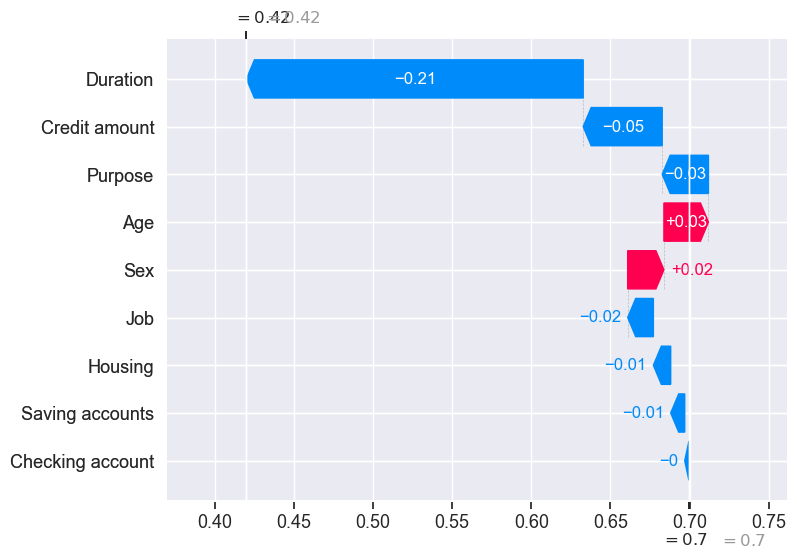

In [90]:
shap.plots._waterfall.waterfall_legacy(explainer_shap.expected_value[1], shap_values[1], feature_names=german.columns)

In [91]:
test_shap_values = explainer_shap.shap_values(X_test)

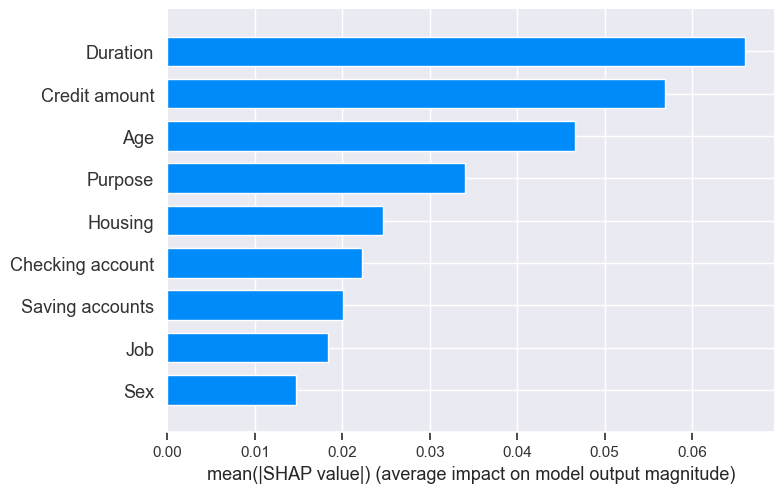

In [92]:
shap.summary_plot(test_shap_values[1][0:100], X_test.iloc[0:100,:], plot_type="bar")

In [93]:
# To create Shapley values visualisations
shap.initjs()  

shap.force_plot(explainer_shap.expected_value[1], test_shap_values[1][0:100], X_test.iloc[0:100,:])

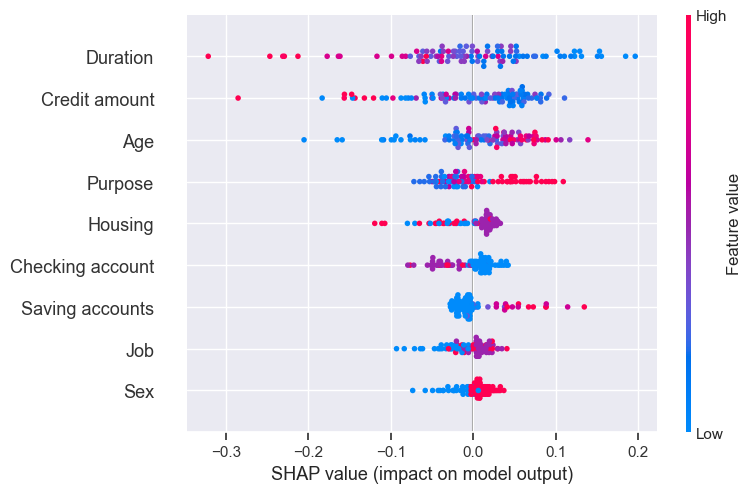

In [94]:
shap.summary_plot(test_shap_values[1][0:100], X_test.iloc[0:100,:])

In [95]:
type(test_shap_values)

list

In [96]:
test_shap_values[1]

array([[ 0.0418268 ,  0.00387708,  0.02990388, ...,  0.08235375,
        -0.02951551, -0.03572487],
       [-0.0767393 , -0.02990091, -0.06407292, ...,  0.02083513,
        -0.08193667, -0.04024861],
       [ 0.07780097,  0.01021998,  0.04096652, ..., -0.14755647,
        -0.06094981, -0.02992157],
       ...,
       [-0.055518  , -0.02598398,  0.01471311, ..., -0.02077655,
         0.05157243, -0.01550336],
       [ 0.06277322,  0.01179301,  0.00648714, ...,  0.05811923,
         0.10286241, -0.01444533],
       [ 0.02162504,  0.00038144, -0.03587301, ..., -0.11323188,
         0.00146403, -0.01290315]])

In [97]:
shap_values

[array([-0.02813991, -0.02287797,  0.0162168 ,  0.01095263,  0.00886153,
         0.00259837,  0.04991487,  0.21279736,  0.02922631]),
 array([ 0.02813991,  0.02287797, -0.0162168 , -0.01095263, -0.00886153,
        -0.00259837, -0.04991487, -0.21279736, -0.02922631])]

In [98]:
#german.select_dtypes(include=[object])

In [99]:
# for i, j  in zip(class_list, categorical_columns):
#     print(j)
#     print(i)
#     print('-'*50)
#     print('')

In [100]:
# X.columns

In [101]:
categorical_columns

['Sex', 'Housing', 'Saving accounts', 'Checking account', 'Purpose', 'Risk']

## SHAP, GradientBoostingClassifier, no resample, no dropped columns

In [102]:
instance = instance_gbc

In [103]:
shap.initjs() 
explainer_shap = shap.TreeExplainer(gbc)

In [104]:
print(gbc.predict_proba(instance.values.reshape(1, -1))[0][1])

0.3192957392802952


In [105]:
shap_values = explainer_shap.shap_values(instance)
print("SHAP values for instance:", shap_values.round(5))
print("Sum of SHAP values:", shap_values.sum().round(5))
print("Expected value:", explainer_shap.expected_value.round(5))
print("Sum of SHAP values and expected value:", (explainer_shap.expected_value + shap_values.sum()).round(5))

SHAP values for instance: [ 0.08261  0.04184  0.02304 -0.17951  0.02154 -0.03746 -0.18091 -1.39125
 -0.18645]
Sum of SHAP values: -1.80655
Expected value: [1.04954]
Sum of SHAP values and expected value: [-0.75701]


In [106]:
shap.initjs()  

shap.force_plot(explainer_shap.expected_value, shap_values, instance)

In [107]:
shap_values

array([ 0.08261451,  0.04184012,  0.02304298, -0.17951287,  0.02154208,
       -0.03746209, -0.1809128 , -1.39125073, -0.18644645])

In [108]:
explainer_shap.expected_value

array([1.04953507])

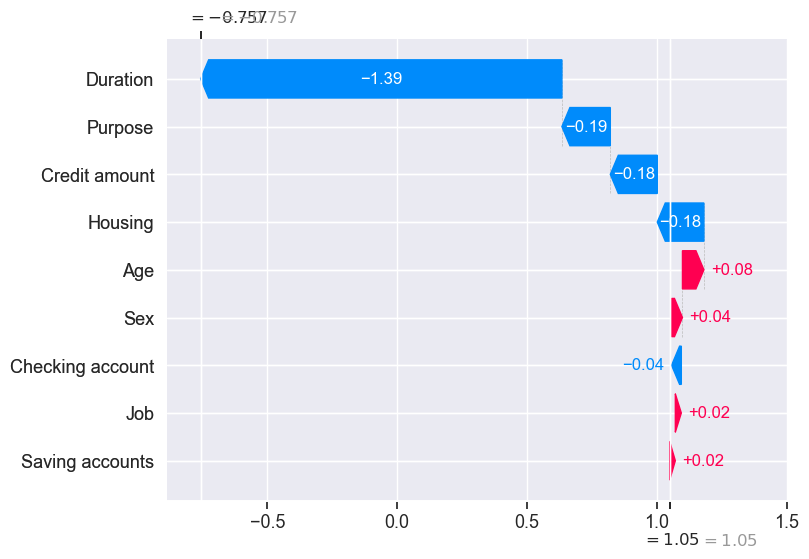

In [109]:
shap.plots._waterfall.waterfall_legacy(explainer_shap.expected_value[0], shap_values, feature_names=german.columns)

In [110]:
test_shap_values = explainer_shap.shap_values(X_test)

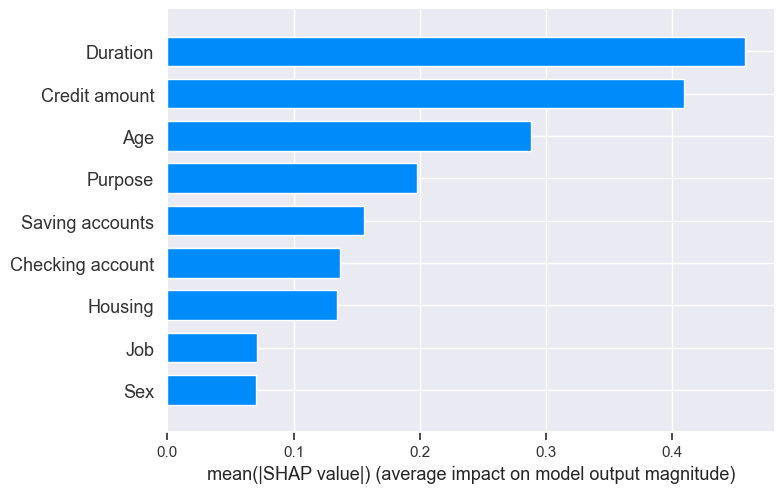

In [111]:
shap.summary_plot(test_shap_values[0:100], X_test.iloc[0:100,:], plot_type="bar")

In [112]:
# To create Shapley values visualisations
shap.initjs()  

shap.force_plot(explainer_shap.expected_value, test_shap_values[0:100], X_test.iloc[0:100,:])

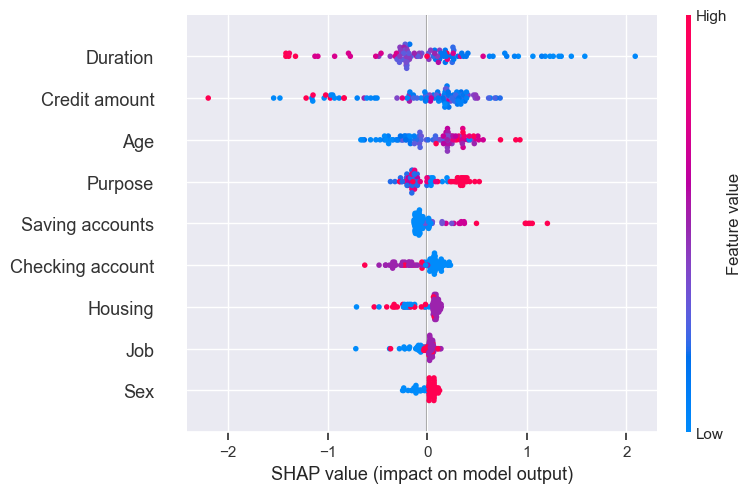

In [113]:
shap.summary_plot(test_shap_values[0:100], X_test.iloc[0:100,:])

In [114]:
type(test_shap_values)

numpy.ndarray

## SHAP, RandomForest, oversample, dropped Sex

In [115]:
instance = instance_rf_res_dropped

In [116]:
shap.initjs() 
explainer_shap = shap.TreeExplainer(rf_res_dropped)

In [117]:
print(rf_res_dropped.predict_proba(instance.values.reshape(1, -1))[0][1])

0.75


In [118]:
shap_values = explainer_shap.shap_values(instance)
print("SHAP values for instance:", shap_values[1].round(5))
print("Sum of SHAP values:", shap_values[1].sum().round(5))
print("Expected value:", explainer_shap.expected_value[1].round(5))
print("Sum of SHAP values and expected value:", (explainer_shap.expected_value[1] + shap_values[1].sum()).round(5))

SHAP values for instance: [ 0.02349  0.02585  0.06386  0.05218 -0.0281   0.09671  0.02541 -0.00683]
Sum of SHAP values: 0.25258
Expected value: 0.49742
Sum of SHAP values and expected value: 0.75


In [119]:
shap.initjs()  

shap.force_plot(explainer_shap.expected_value[1], shap_values[1], instance)

In [120]:
shap_values

[array([-0.02349157, -0.02585018, -0.06386007, -0.05218127,  0.02809731,
        -0.09671382, -0.02540877,  0.00682801]),
 array([ 0.02349157,  0.02585018,  0.06386007,  0.05218127, -0.02809731,
         0.09671382,  0.02540877, -0.00682801])]

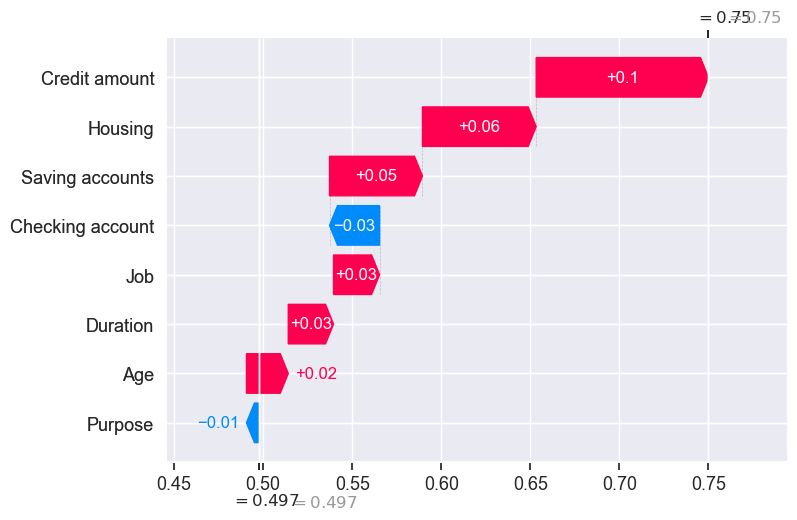

In [121]:
shap.plots._waterfall.waterfall_legacy(explainer_shap.expected_value[1], shap_values[1], feature_names=X_dropped.columns)

In [122]:
test_shap_values = explainer_shap.shap_values(X_test_res_dropped)

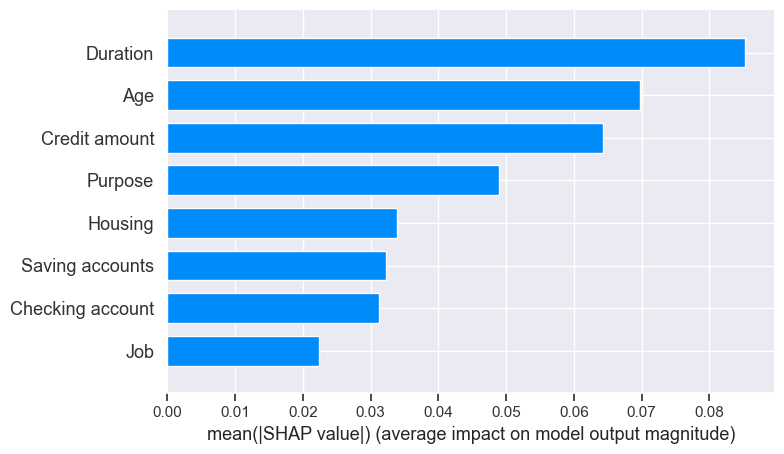

In [123]:
shap.summary_plot(test_shap_values[1][0:100], X_test_res_dropped.iloc[0:100,:], plot_type="bar")

In [124]:
# To create Shapley values visualisations
shap.initjs()  

shap.force_plot(explainer_shap.expected_value[1], test_shap_values[1][0:100], X_test_res_dropped.iloc[0:100,:])

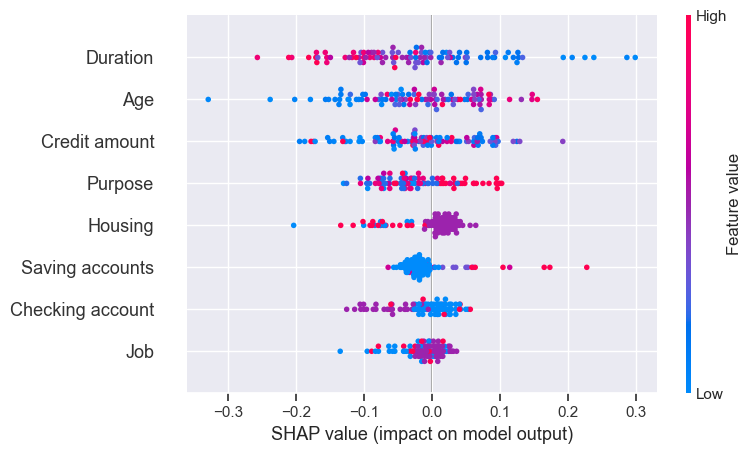

In [125]:
shap.summary_plot(test_shap_values[1][0:100], X_test_res_dropped.iloc[0:100,:])

## SHAP, GBC, oversample, dropped Sex

In [126]:
instance = instance_gbc_res_dropped

In [127]:
shap.initjs() 
explainer_shap = shap.TreeExplainer(gbc_res_dropped)

In [128]:
print(gbc_res_dropped.predict_proba(instance.values.reshape(1, -1))[0][1])

0.6388090307105388


In [129]:
shap_values = explainer_shap.shap_values(instance)
print("SHAP values for instance:", shap_values.round(5))
print("Sum of SHAP values:", shap_values.sum().round(5))
print("Expected value:", explainer_shap.expected_value.round(5))
print("Sum of SHAP values and expected value:", (explainer_shap.expected_value + shap_values.sum()).round(5))

SHAP values for instance: [-0.01238  0.04302  0.1794   0.10936 -0.21469  0.57293 -0.02146 -0.10128]
Sum of SHAP values: 0.55489
Expected value: [0.01531]
Sum of SHAP values and expected value: [0.5702]


In [130]:
shap.initjs()  

shap.force_plot(explainer_shap.expected_value, shap_values, instance)

In [131]:
shap_values

array([-0.01238429,  0.04301642,  0.17940403,  0.10935677, -0.21469049,
        0.57292567, -0.02145829, -0.10127784])

In [132]:
explainer_shap.expected_value

array([0.01530675])

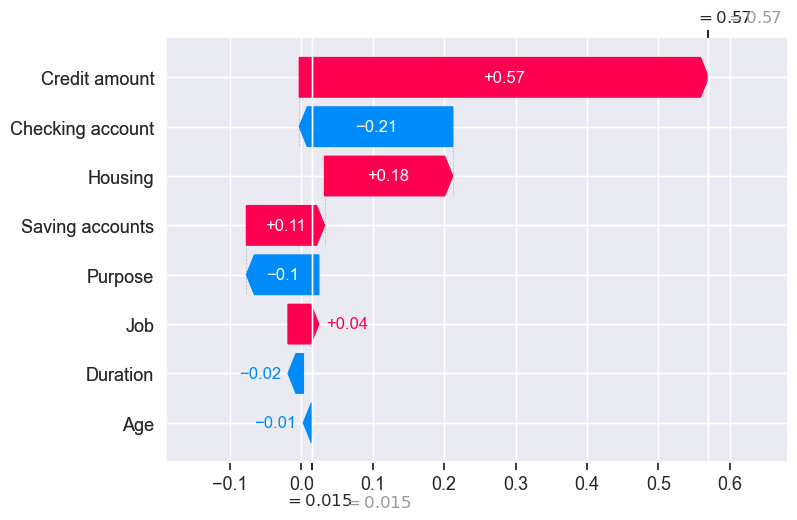

In [133]:
shap.plots._waterfall.waterfall_legacy(explainer_shap.expected_value[0], shap_values, feature_names=X_res_dropped.columns)

In [134]:
test_shap_values = explainer_shap.shap_values(X_test_res_dropped)

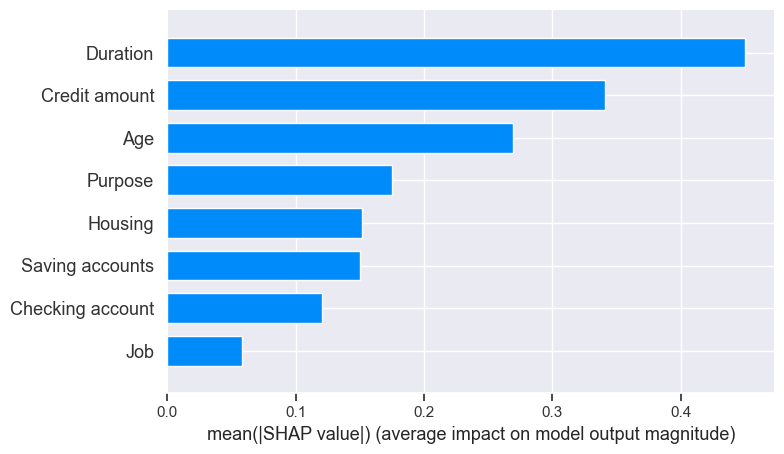

In [135]:
shap.summary_plot(test_shap_values[0:100], X_test_res_dropped.iloc[0:100,:], plot_type="bar")

In [136]:
# To create Shapley values visualisations
shap.initjs()  

shap.force_plot(explainer_shap.expected_value, test_shap_values[0:100], X_test_res_dropped.iloc[0:100,:])

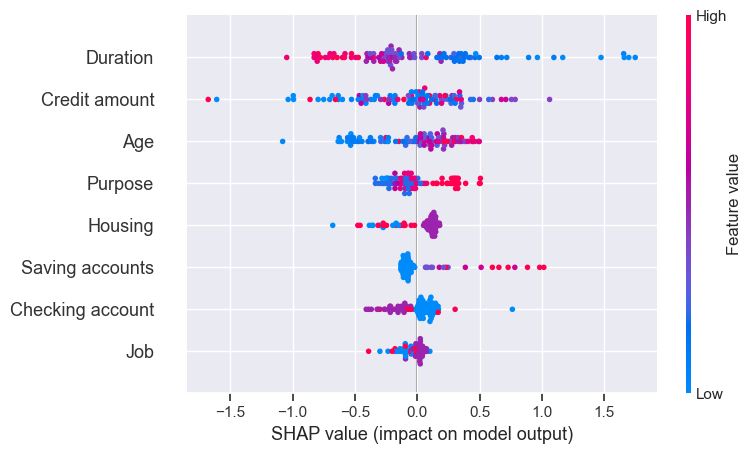

In [137]:
shap.summary_plot(test_shap_values[0:100], X_test_res_dropped.iloc[0:100,:])

# SHAP for whole model GradientBoostingClassifier, no resample, no dropped columns (other types of plots)

In [138]:
model = GradientBoostingClassifier(random_state=42).fit(X, y)
# compute SHAP values
explainer_gbc = shap.Explainer(model, X)
shap_values_gbc = explainer_gbc(X[:])

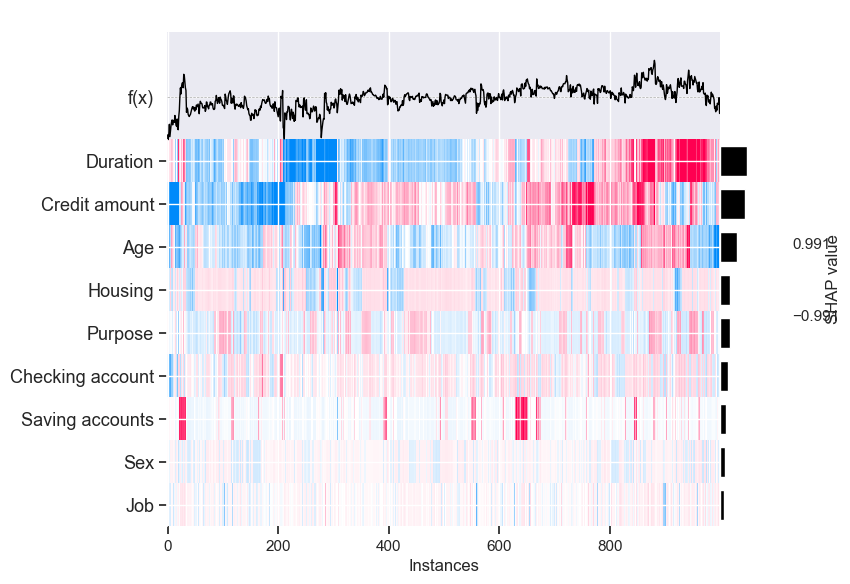

In [139]:
shap.plots.heatmap(shap_values_gbc)

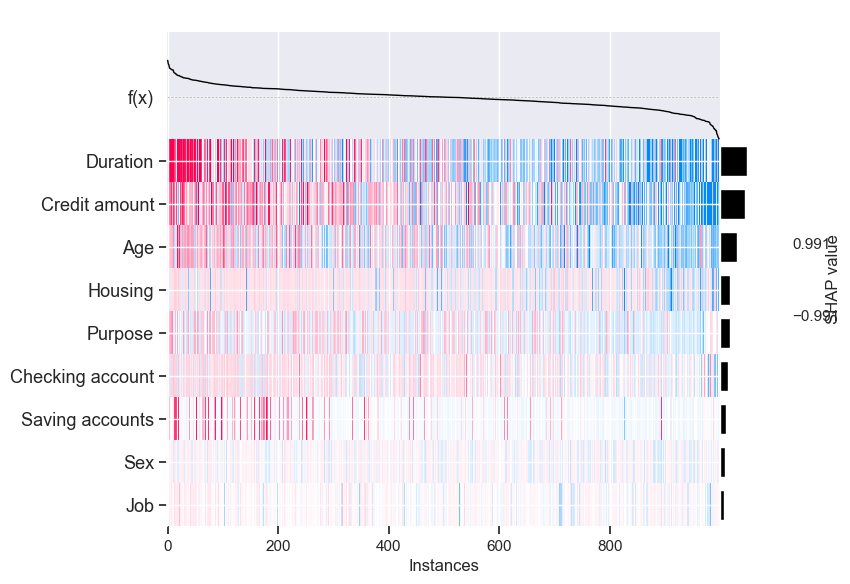

In [140]:
shap.plots.heatmap(shap_values_gbc, instance_order=shap_values_gbc.sum(1))

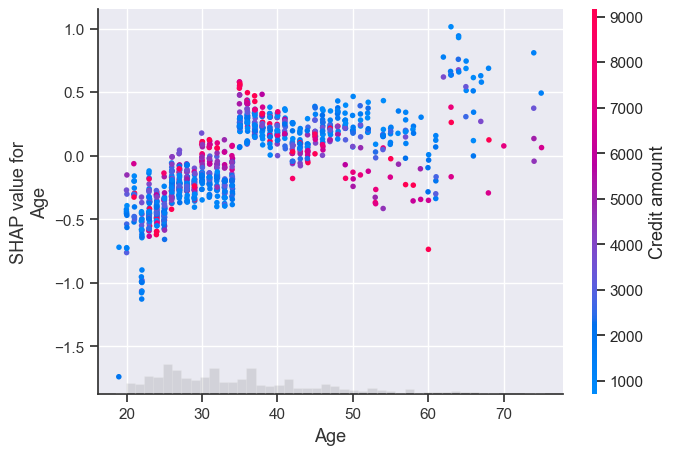

In [141]:
shap.plots.scatter(shap_values_gbc[:,"Age"], color = shap_values_gbc)

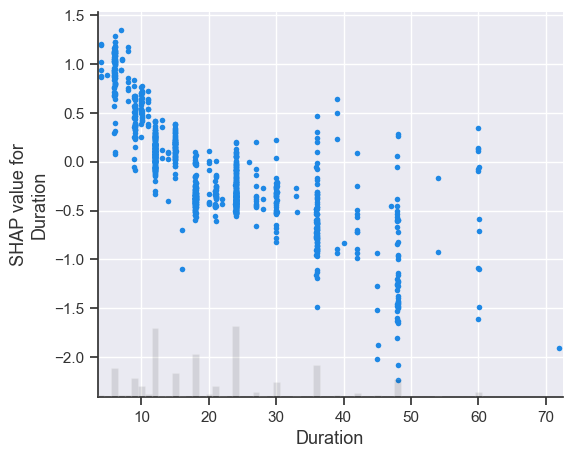

In [142]:
shap.plots.scatter(shap_values_gbc[:, shap_values_gbc.abs.mean(0).argsort[-1]])

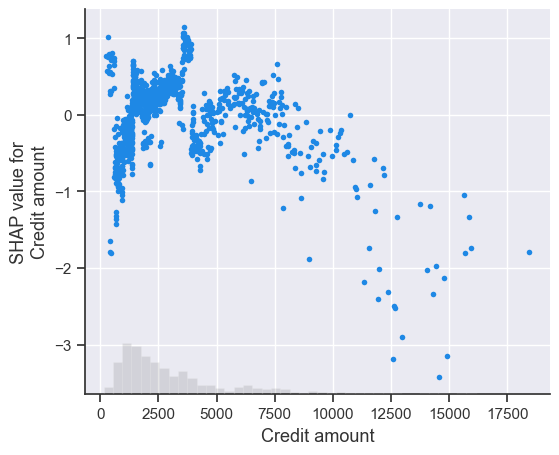

In [143]:
shap.plots.scatter(shap_values_gbc[:, shap_values_gbc.abs.max(0).argsort[-1]])

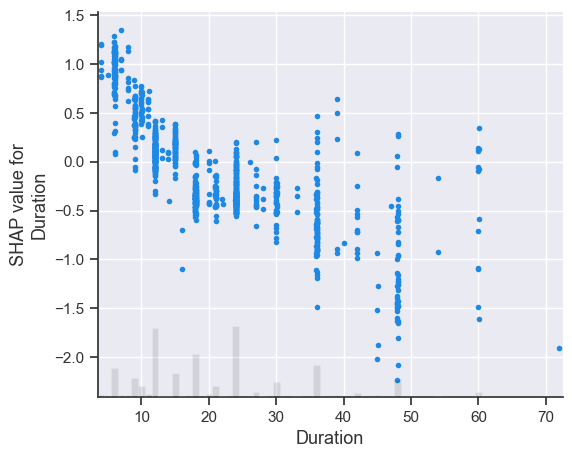

In [144]:
shap.plots.scatter(shap_values_gbc[:, shap_values_gbc.abs.percentile(95, 0).argsort[-1]])

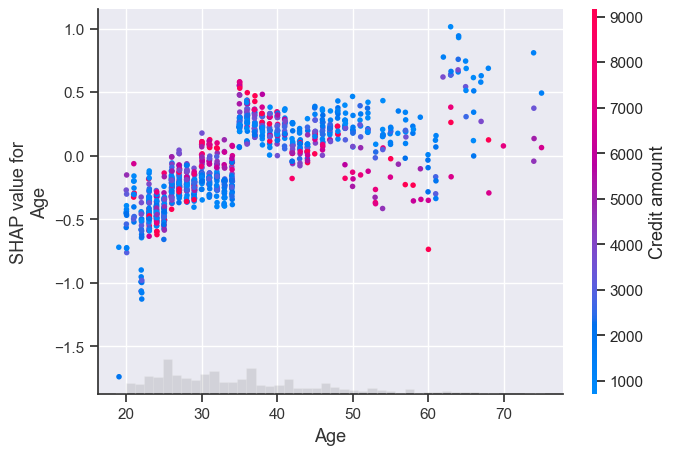

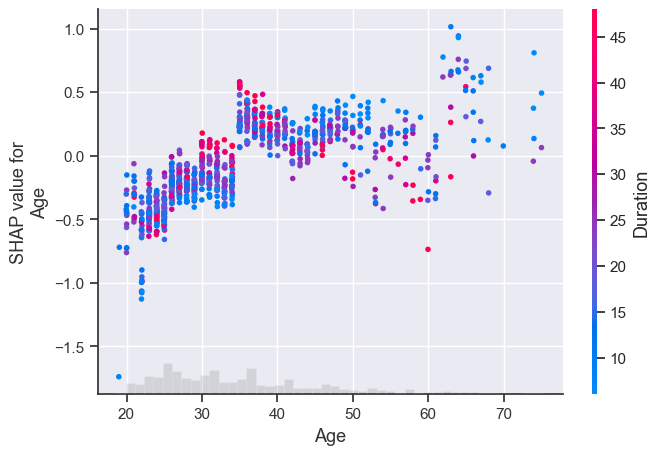

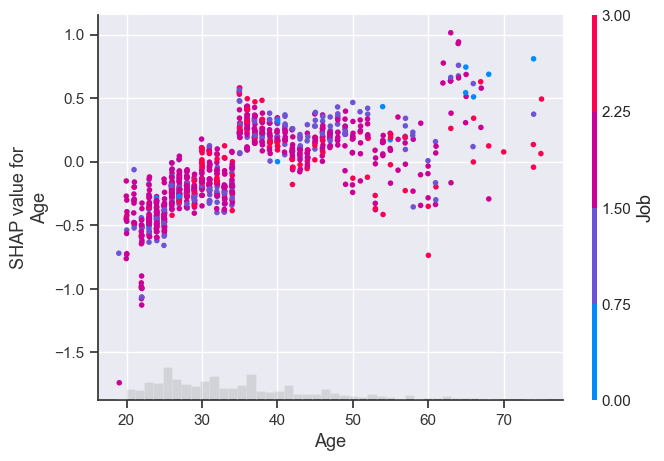

In [145]:
# we can use shap.approximate_interactions to guess which features
# may interact with age
inds = shap.utils.potential_interactions(shap_values_gbc[:, "Age"], shap_values_gbc)

# make plots colored by each of the top three possible interacting features
for i in range(3):
    shap.plots.scatter(shap_values_gbc[:,"Age"], color=shap_values_gbc[:,inds[i]])

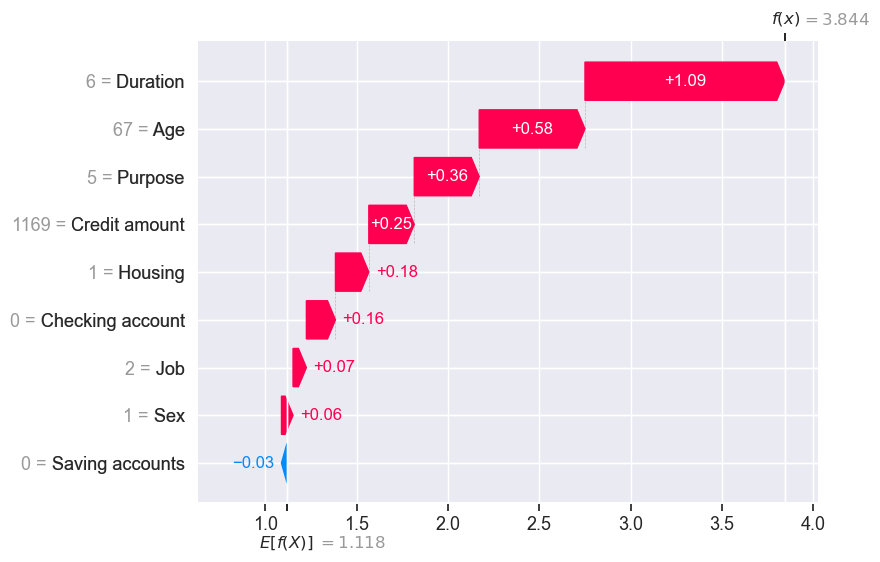

In [146]:
shap.plots.waterfall(shap_values_gbc[0])

# Using just duration and credit amount as features

In [147]:
german.head()

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,Risk
0,67,1,2,1,0,0,1169,6,5,1
1,22,0,2,1,0,1,5951,48,5,0
2,49,1,1,1,0,0,2096,12,3,1
3,45,1,2,0,0,0,7882,42,4,1
4,53,1,2,0,0,0,4870,24,1,0


In [148]:
X_plain = german.drop(['Age', 'Sex', 'Job', 'Housing', 'Saving accounts', 'Checking account', 'Purpose', 'Risk'], axis=1)
y_plain = german['Risk']

X_plain.head()

,Credit amount,Duration
0,1169,6
1,5951,48
2,2096,12
3,7882,42
4,4870,24


In [149]:
ros = RandomOverSampler(random_state=42)

X_plain_res, y_plain_res = ros.fit_resample(X_plain, y_plain)

X_train_plain_res, X_test_plain_res, y_train_plain_res, y_test_plain_res = train_test_split(X_plain_res, 
                                                                                                    y_plain_res, 
                                                                                                    test_size=0.2,
                                                                                                    stratify = y_plain_res,
                                                                                                    random_state=42)

print(X_train_plain_res.shape)
print(y_train_plain_res.shape)
print(X_test_plain_res.shape)
print(y_test_plain_res.shape)


rf_res_plain = RandomForestClassifier(random_state = 42)

rf_res_plain.fit(X_train_plain_res, y_train_plain_res)

preds_rf_res_plain = rf_res_plain.predict(X_test_plain_res)

print(classification_report(y_test_plain_res, preds_rf_res_plain)) 

(1120, 2)
(1120,)
(280, 2)
(280,)
              precision    recall  f1-score   support

           0       0.77      0.96      0.85       140
           1       0.94      0.71      0.81       140

    accuracy                           0.84       280
   macro avg       0.86      0.84      0.83       280
weighted avg       0.86      0.84      0.83       280



#### Using only 2 features we still achieve 83% F1 score compared to 88% when we use all covariates

# PCA (not relevant, just interesting)

[9.99971939e-01 1.64080189e-05 1.09425482e-05 4.77536028e-07
 8.08921182e-08 5.05344157e-08 4.51564283e-08 3.31307913e-08
 2.29733097e-08]
PCA score: -23.349827314867703


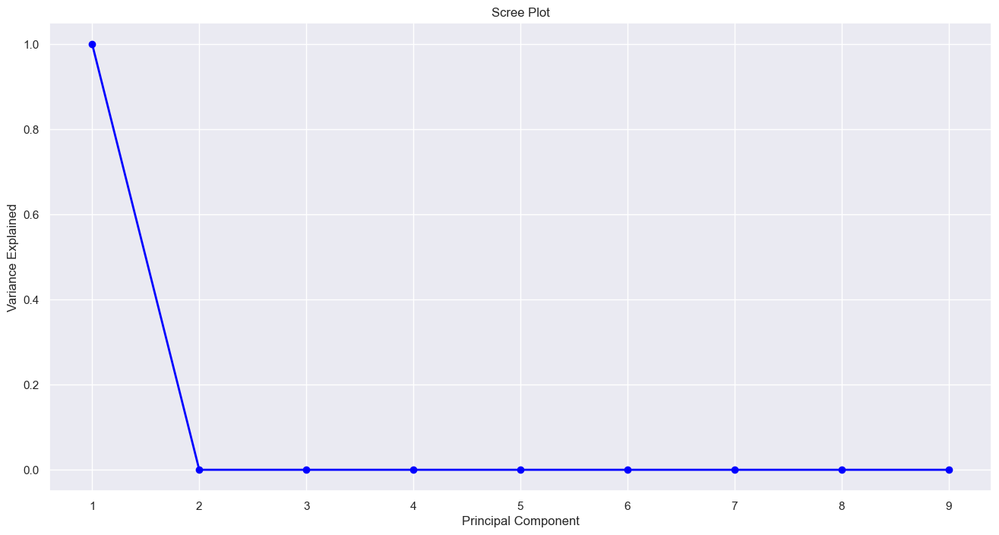

In [150]:
n_components = 9

pca = PCA(n_components = n_components, random_state = 42)

pca.fit(X)
print(pca.explained_variance_ratio_)
print(f'PCA score: {pca.score(X)}')

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'o-', linewidth=2, color='blue')
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
plt.show()

#### Using only 1 Principal component we capture all the variance in the dataset. This is irrelevant to this assignment, but still interesting

# T-SNE

In [151]:
# time_start = time.time()
# tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
# tsne_results = tsne.fit_transform(X)

# print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))
# A  = tsne_results[:,0]
# B  = tsne_results[:,1]


# plt.figure(figsize=(16,10))
# sns.scatterplot(data=tsne_results,
#     legend="full",
#     alpha=0.3
# )